# Cellular Behavior Analysis
This notebook uses autoencoders to explore dynamic cellular behaviors

In [59]:
import os
import numpy as np

import tensorflow as tf
import tensorflow_addons as tfa
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
print(tf.__version__)
AUTOTUNE = tf.data.experimental.AUTOTUNE

import deepcell
from deepcell_tracking.utils import Track, load_trks
from sklearn.model_selection import train_test_split
from deepcell.utils.data_utils import reshape_movie
from deepcell.utils.transform_utils import erode_edges
from deepcell.data import split_dataset
from deepcell_toolbox.processing import normalize, histogram_normalization

import spektral

2.5.0


## Load data

In [60]:
%%time
path_temp_trks = '/data/3T3_nuc_s0-s2.trks'
all_data = [load_trks(path_temp_trks)]

CPU times: user 450 ms, sys: 856 ms, total: 1.31 s
Wall time: 1.49 s


In [61]:
%%time
all_tracks = [Track(tracked_data=d) for d in all_data]

CPU times: user 1min 51s, sys: 6.88 s, total: 1min 58s
Wall time: 1min 46s


In [62]:
%%time
from deepcell_tracking.utils import concat_tracks
track_info = concat_tracks(all_tracks)

CPU times: user 571 ms, sys: 796 ms, total: 1.37 s
Wall time: 632 ms


In [63]:
for k, v in track_info.items():
    print(k, v.shape)

appearances (11, 71, 168, 32, 32, 1)
centroids (11, 71, 168, 2)
morphologies (11, 71, 168, 3)
adj_matrices (11, 71, 168, 168)
norm_adj_matrices (11, 71, 168, 168)
temporal_adj_matrices (11, 70, 168, 168, 3)


## Convert data to tf.data.Dataset

In [64]:
from skimage.exposure import rescale_intensity

def norm(X):
    X_norm = histogram_normalization(X, kernel_size=32)
    
    X_rescaled = np.zeros(X_norm.shape)
    for batch in range(X.shape[0]):
        for frame in range(X.shape[1]):
            x = X[batch, frame]
            x = rescale_intensity(x, out_range=(0,1))
            X_rescaled[batch, frame] = x
            
    return X_rescaled

def prepare_dataset(track_info, batch_size=1, buffer_size=256,
                    seed=None, val_split=0.2):
    
    # Merge tracks along the batch axis
    appearances = track_info['appearances']
    
    app_shape = np.shape(appearances)
    appearances = np.swapaxes(appearances, 1,2) #(0,2,1,3,4,5))
    appearances = np.reshape(appearances, [-1, app_shape[1], app_shape[3], app_shape[4], app_shape[5]])
    
    # Normalize appearances
    appearances = norm(appearances)
    
    input_dict = {'appearances': appearances}
    
    output_dict = {'appearances_decoder': appearances}
    
    dataset = tf.data.Dataset.from_tensor_slices((input_dict, output_dict))
    
    dataset = dataset.shuffle(buffer_size, seed=seed)
    
    # split into train/val
    train_data, val_data = split_dataset(dataset, val_split)
    
    # batch the data
    train_data = train_data.repeat().batch(batch_size)
    val_data = val_data.repeat().batch(batch_size)
    
    # prefetch the data
    train_data = train_data.prefetch(tf.data.AUTOTUNE)
    val_data = val_data.prefetch(tf.data.AUTOTUNE)
    
    return train_data, val_data

In [65]:
train_data, val_data = prepare_dataset(track_info,
                                       batch_size=1)

In [66]:
it = iter(train_data)

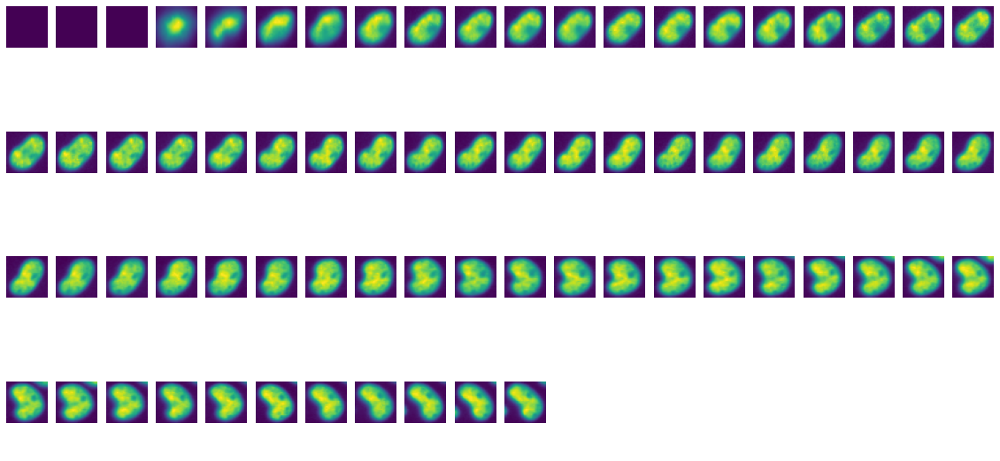

In [67]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(4,20,figsize=(20,10))

for ax in axes.flatten():
    ax.set_axis_off()
    
nxt = it.next()
for j in range(71):
    axes.flatten()[j].imshow(nxt[0]['appearances'][0,j])
    axes.flatten()[j].set_axis_off()

## Construct autoencoder

In [68]:
import numpy as np
import tensorflow as tf

from tensorflow.keras import backend as K
from tensorflow.keras import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import TimeDistributed, Conv2D, Conv3D, LSTM, Conv2DTranspose
from tensorflow.keras.layers import Input, Concatenate, InputLayer
from tensorflow.keras.layers import Add, Subtract, Dense, Reshape
from tensorflow.keras.layers import MaxPool3D, UpSampling3D
from tensorflow.keras.layers import Activation, Softmax
from tensorflow.keras.layers import BatchNormalization, Lambda
from tensorflow_addons.layers import InstanceNormalization


in_kwargs = {'axis':-1,
             'center': True,
             'scale': True,
             'beta_initializer': 'random_uniform',
             'gamma_initializer': 'random_uniform'}

def residual_block(input_tensor, n_filters=64):
    y = Conv3D(n_filters,
           (1, 3, 3),
           strides=1,
           padding='same')(input_tensor)
    y = InstanceNormalization(**in_kwargs)(y)
    y = Activation('relu')(y)
    
    y = Conv3D(n_filters,
           (1, 3, 3),
           strides=1,
           padding='same')(y)
    y = InstanceNormalization(**in_kwargs)(y)
    y = Activation('relu')(y)
    
    y = Add()([input_tensor, y])
    
    return y
    
class TrajectoryEncoder():   
    def __init__(self,
                 n_filters = 64,
                 encoder_dim=256,
                 embedding_dim=1024,
                 appearance_shape=(71,32,32,1)):
        
        self.n_filters = n_filters
        self.encoder_dim = encoder_dim
        self.embedding_dim = embedding_dim
        self.appearance_shape = appearance_shape
        
        # create encoder
        self.app_encoder = self.get_appearance_encoder()
        
        # create embedding
        self.embedding_model = self.get_embedding_model()
        
        # create decoder
        self.app_decoder = self.get_appearance_decoder()
        
        # create autoencoder
        self.autoencoder = self.get_autoencoder()
    
    def get_appearance_encoder(self):
        app_shape = tuple([None] + list(self.appearance_shape)[1:])
        inputs = Input(shape=app_shape, name='encoder_app_input')

        x = inputs
        x = Conv3D(self.n_filters,
                       (1,3,3),
                       strides=1,
                       padding='same')(x)
        
        for i in range(5): 
            x = residual_block(x, self.n_filters)
            x = residual_block(x, self.n_filters)

            x = Conv3D(self.n_filters, 
                       (1,2,2), 
                       strides=(1,2,2), 
                       padding='valid',
                       use_bias=False)(x)
            
        x = Lambda(lambda t: tf.squeeze(t, axis=(2, 3)))(x)
        x = Dense(self.encoder_dim, name='dense_aeout')(x)
        x = Activation('relu', name='appearance_embedding')(x)
        return Model(inputs=inputs, outputs=x, name='appearance_encoder')
        
    def get_embedding_model(self):
        encoded_shape = tuple([None, self.encoder_dim])
        inputs = Input(shape=encoded_shape, name='embedding_model_input')
        
        x = inputs
        x = Dense(self.embedding_dim)(x)
        x = Activation('relu', name='embedding')(x)
        return Model(inputs=inputs, outputs=x, name='embedding')
    
    def get_appearance_decoder(self):
        embedding_shape = tuple([None, self.embedding_dim])
        inputs = Input(shape=embedding_shape, name='encoder_app_input')

        x = inputs
        x = Lambda(lambda t: tf.expand_dims(t, axis=-2))(x)
        x = Lambda(lambda t: tf.expand_dims(t, axis=-2))(x)
        
        x = Conv3D(self.n_filters,
               (1,3,3),
               strides=1,
               padding='same')(x)
        
        for i in range(5): 
            x = residual_block(x, self.n_filters)
            x = residual_block(x, self.n_filters)
            x = UpSampling3D(size=(1, 2, 2))(x)
            
        x = Dense(1, name='appearance_reconstruction')(x)
        return Model(inputs=inputs, outputs=x, name='appearances_decoder')
        
    def get_autoencoder(self):
        app_input = Input(shape=self.appearance_shape, name='appearances')

        x = self.app_encoder(app_input)
        embedding = self.embedding_model(x)
        reconstruction = self.app_decoder(embedding)

        inputs = app_input
        outputs = [embedding, reconstruction]
        return Model(inputs=inputs, outputs=[embedding, reconstruction])

In [69]:
TE = TrajectoryEncoder()

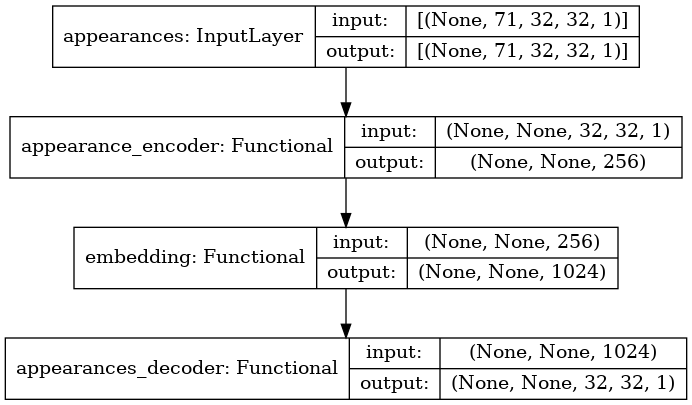

In [70]:
from tensorflow.keras.utils import plot_model
plot_model(TE.autoencoder, show_shapes=True)

In [71]:
def self_supervised_loss(y_true, y_pred):
    
    # Pair the current embedding with the future ground truth
    # so that we predict the future from the past
    
    current_reconstruction = y_pred
    gt = y_true
    
    loss = tf.keras.metrics.mean_squared_error(gt, current_reconstruction)
    
    return loss

## Train autoencoder

In [72]:
from tensorflow_addons.optimizers import RectifiedAdam as RAdam
from deepcell import train_utils

# Define optimizer
optimizer = RAdam(lr=1e-3, clipnorm=0.001)
losses = {'appearances_decoder': self_supervised_loss}
num_gpus = train_utils.count_gpus()
print('Training on {} GPUs'.format(num_gpus))

# Compile model
TE.autoencoder.compile(optimizer=optimizer, loss=losses)

# Train the model
model_path = '/data/models/ssl'
steps_per_epoch = 2048
validation_steps = 100
n_epochs = 1

train_callbacks = [
    tf.keras.callbacks.ModelCheckpoint(
        model_path, monitor='val_loss',
        save_best_only=True, verbose=1,
        save_weights_only=False),
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss', factor=0.5, verbose=1,
        patience=3, min_lr=1e-7)
]

loss_history = TE.autoencoder.fit(
    train_data,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_data,
    validation_steps=validation_steps,
    epochs=n_epochs,
    verbose=1,
    callbacks=train_callbacks)

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


Training on 1 GPUs
2048/2048 [==============================] - 370s 160ms/step - loss: 0.0145 - appearances_decoder_loss: 0.0145 - val_loss: 0.0122 - val_appearances_decoder_loss: 0.0122

Epoch 00001: val_loss improved from inf to 0.01219, saving model to /data/models/ssl


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /data/models/ssl/assets


INFO:tensorflow:Assets written to: /data/models/ssl/assets


## Visualize reconstruction

In [16]:
it = iter(train_data)

In [42]:
nxt = it.next()
inputs = nxt[0]['appearances']

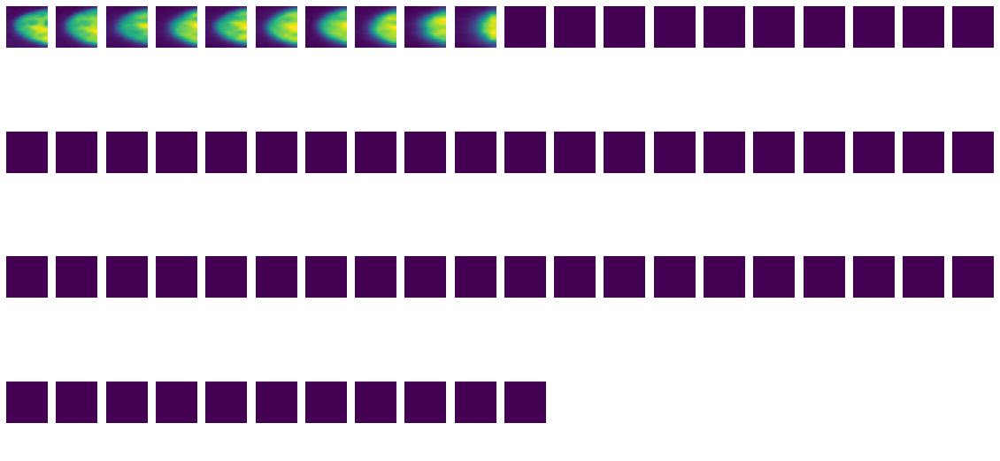

In [43]:
fig, axes = plt.subplots(4,20,figsize=(20,10))

for ax in axes.flatten():
    ax.set_axis_off()
    
for j in range(71):
    axes.flatten()[j].imshow(inputs[0,j])
    axes.flatten()[j].set_axis_off()

In [19]:
app_encoded = TE.app_encoder(inputs)
embedding = TE.embedding_model(app_encoded)
reconstruction = TE.app_decoder(embedding)

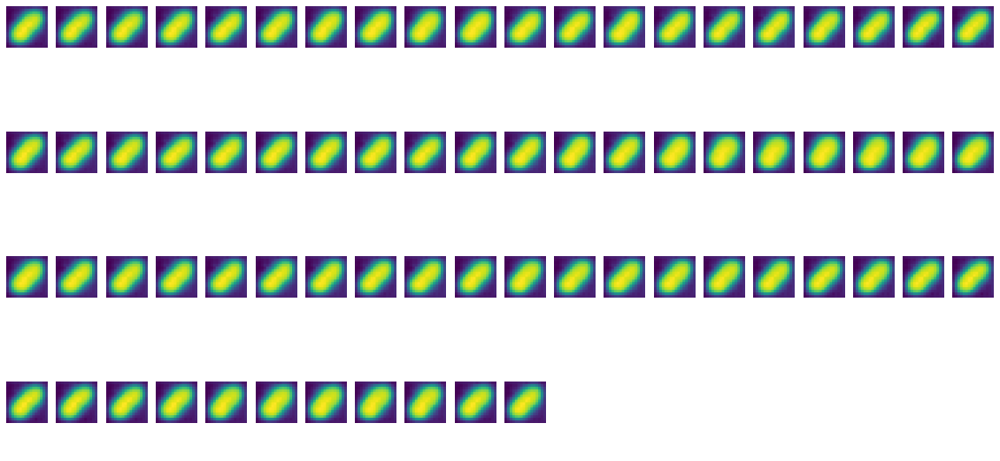

In [20]:
fig, axes = plt.subplots(4,20,figsize=(20,10))

for ax in axes.flatten():
    ax.set_axis_off()
    
for j in range(71):
    axes.flatten()[j].imshow(reconstruction[0,j])
    axes.flatten()[j].set_axis_off()

## Visualize embedding

In [21]:
outputs = TE.autoencoder.predict()

TypeError: predict() missing 1 required positional argument: 'x'

In [22]:
type(train_data)

tensorflow.python.data.ops.dataset_ops.PrefetchDataset

In [27]:
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

for range(num_cells):
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    for embedding in embeddings:
        print(embedding[:10])

SyntaxError: invalid syntax (<ipython-input-27-609a0daf06b1>, line 10)

In [30]:
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

for cell in range(num_cells):
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    for embedding in embeddings:
        #print(embedding[:10])

SyntaxError: unexpected EOF while parsing (<ipython-input-30-fc549b47311f>, line 14)

In [31]:
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temporal_embeddings = {}
for frame in range(shape[1]):
    temporal_embeddings[frame] = []

for cell in range(num_cells):
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    for frame in range(len(embeddings)):
        temporal_embeddings[frame].append(embeddings[frame])

In [32]:
len(temporal_embeddings.get(0))

1848

In [33]:
len(temporal_embeddings.get(35))

0

In [34]:
len(temporal_embeddings.get(1))

0

In [35]:
temporal_embeddings.keys()

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70])

In [17]:
# compile temporal_embeddings

it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temporal_embeddings = {}
for frame in range(shape[1]):
    temporal_embeddings[frame] = []

for cell in range(num_cells):
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temporal_embeddings[frame].append(embeddings[0][frame])

In [41]:
len(temporal_embeddings[0])

1848

In [42]:
len(temporal_embeddings[1])

1848

In [22]:
for frame in range(shape[1]):
    print(len(temporal_embeddings.get(frame)))

1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848
1848


In [47]:
import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    nxt = it.next()
    inputs = nxt[0]['appearances']

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_dict = {}
    for frame in range(shape[1]):
        temp_embeddings_dict[frame] = []

    for cell in range(num_cells):
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            temp_embeddings_dict[frame].append(embeddings[0][frame])
            
    temp_embedding_lst = []
    for frame in temp_embeddings_dict:
        for embedding in temp_embeddings_dict[frame]:
            temp_embedding_lst.append(embedding.append(frame))
            
    embedding_dim = len(temp_embedding_dict[0][0])
    temp_embedding_df = pd.Dataframe(temp_embedding_lst, columns=[idx for idx in range(embedding_dim)].append('Frame'))
    
    return temp_embeddings_df

In [48]:
temp_embeddings_df = get_temp_embeddings_df()

AttributeError: 'tensorflow.python.framework.ops.EagerTensor' object has no attribute 'append'

In [51]:
import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    nxt = it.next()
    inputs = nxt[0]['appearances']

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_dict = {}
    for frame in range(shape[1]):
        temp_embeddings_dict[frame] = []

    for cell in range(num_cells):
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            temp_embeddings_dict[frame].append(embeddings[0][frame])
            
    temp_embedding_lst = []
    for frame in temp_embeddings_dict:
        for embedding in temp_embeddings_dict[frame]:
            temp_embedding_lst.append(list(embedding).append(frame))
            
    embedding_dim = len(temp_embedding_dict[0][0])
    indices = [idx for idx in range(embedding_dim)]
    temp_embedding_df = pd.Dataframe(temp_embedding_lst, columns=indices.append('Frame'))
    
    return temp_embeddings_df

In [52]:
temp_embeddings_df = get_temp_embeddings_df()

KeyboardInterrupt: 

In [24]:
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_dict = {}
for frame in range(shape[1]):
    temp_embeddings_dict[frame] = []

In [25]:
%%time
for cell in range(num_cells):
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temp_embeddings_dict[frame].append(embeddings[0][frame])

KeyboardInterrupt: 

In [26]:
%%time
temp_embedding_lst = []
for frame in temp_embeddings_dict:
    for embedding in temp_embeddings_dict[frame]:
        print(frame)
        temp_embedding_lst.append(list(embedding).append(frame))

0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


KeyboardInterrupt: 

In [27]:
import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    nxt = it.next()
    inputs = nxt[0]['appearances']

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            temp_embeddings_lst.append(list(embeddings[0][frame]).append(frame))
            
    embedding_dim = len(embeddings.shape[2])
    indices = [idx for idx in range(embedding_dim)]
    temp_embedding_df = pd.Dataframe(temp_embedding_lst, columns=indices.append('Frame'))
    
    return temp_embeddings_df

In [20]:
%%time
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

CPU times: user 671 ms, sys: 769 ms, total: 1.44 s
Wall time: 1.25 s


In [21]:
%%time
for cell in range(num_cells):
    print(cell)
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temp_embeddings_lst.append(list(embeddings[0][frame]).append(frame))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [28]:
%%time
import pandas as pd

embedding_dim = embeddings.shape[2]
indices = [idx for idx in range(embedding_dim)]
temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=indices.append('Frame'))

CPU times: user 28.7 ms, sys: 3.99 ms, total: 32.7 ms
Wall time: 32 ms


In [29]:
temp_embeddings_df.to_csv('temp_embeddings.csv', columns=indices.append('Frame'))

In [30]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv')

In [31]:
temp_embeddings_df[:5]

,Unnamed: 0,0
0,0,NaN
1,1,NaN
2,2,NaN
3,3,NaN
4,4,NaN


In [32]:
temp_embedding_df[:5]

,0
0,None
1,None
2,None
3,None
4,None


In [33]:
num_cells

1848

In [34]:
temp_embeddings_lst[:5]

[None, None, None, None, None]

In [35]:
it = iter(train_data)

nxt = it.next()
inputs = nxt[0]['appearances']

In [36]:
inputs == train_data[0][0]['appearances']

TypeError: 'PrefetchDataset' object does not support indexing

In [37]:
inputs

<tf.Tensor: shape=(1, 71, 32, 32, 1), dtype=float64, numpy=
array([[[[[7.50121754e-03],
          [7.93960039e-03],
          [1.16902089e-03],
          ...,
          [1.58304926e-02],
          [6.42961496e-03],
          [6.72187051e-03]],

         [[4.48124716e-03],
          [3.31222592e-03],
          [7.45250843e-03],
          ...,
          [1.63175836e-02],
          [2.13346314e-02],
          [1.12518268e-02]],

         [[4.38382849e-03],
          [2.19191425e-03],
          [9.88796912e-03],
          ...,
          [3.81393097e-02],
          [3.07842176e-02],
          [2.55236235e-02]],

         ...,

         [[3.20993662e-02],
          [4.99269366e-02],
          [9.94154885e-02],
          ...,
          [1.73940569e-01],
          [5.14028251e-01],
          [8.77739906e-01]],

         [[1.84607897e-02],
          [3.01509984e-02],
          [5.06575741e-02],
          ...,
          [1.84120804e-01],
          [5.33560634e-01],
          [9.27812934e-01]],



In [38]:
inputs

<tf.Tensor: shape=(1, 71, 32, 32, 1), dtype=float64, numpy=
array([[[[[7.50121754e-03],
          [7.93960039e-03],
          [1.16902089e-03],
          ...,
          [1.58304926e-02],
          [6.42961496e-03],
          [6.72187051e-03]],

         [[4.48124716e-03],
          [3.31222592e-03],
          [7.45250843e-03],
          ...,
          [1.63175836e-02],
          [2.13346314e-02],
          [1.12518268e-02]],

         [[4.38382849e-03],
          [2.19191425e-03],
          [9.88796912e-03],
          ...,
          [3.81393097e-02],
          [3.07842176e-02],
          [2.55236235e-02]],

         ...,

         [[3.20993662e-02],
          [4.99269366e-02],
          [9.94154885e-02],
          ...,
          [1.73940569e-01],
          [5.14028251e-01],
          [8.77739906e-01]],

         [[1.84607897e-02],
          [3.01509984e-02],
          [5.06575741e-02],
          ...,
          [1.84120804e-01],
          [5.33560634e-01],
          [9.27812934e-01]],



In [44]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

for cell in range(5):
    print(cell)
    nxt = it.next()
    inputs = nxt[0]['appearances']
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temp_embeddings_lst.append(list(embeddings[0][frame]).append(frame))

0
1
2
3
4


In [45]:
temp_embeddings_lst[0]

In [46]:
temp_embeddings_lst[:5]

[None, None, None, None, None]

In [47]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [48]:
it.next()

({'appearances': <tf.Tensor: shape=(1, 71, 32, 32, 1), dtype=float64, numpy=
  array([[[[[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],
  
           [[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],
  
           [[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],
  
           ...,
  
           [[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],
  
           [[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],
  
           [[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]]],
  
  
          [[[0.],
            [0.],
            [0.],
            ...,
            [0.],
            [0.],
            [0.]],


In [49]:
it.next()

({'appearances': <tf.Tensor: shape=(1, 71, 32, 32, 1), dtype=float64, numpy=
  array([[[[[0.0596509 ],
            [0.02394341],
            [0.03456263],
            ...,
            [0.02508511],
            [0.02976   ],
            [0.02835945]],
  
           [[0.04838511],
            [0.05443889],
            [0.05239629],
            ...,
            [0.00167881],
            [0.00754596],
            [0.        ]],
  
           [[0.04605252],
            [0.02647753],
            [0.06196273],
            ...,
            [0.01225267],
            [0.02620492],
            [0.03379014]],
  
           ...,
  
           [[0.05266756],
            [0.06636547],
            [0.07012231],
            ...,
            [0.07443567],
            [0.11147736],
            [0.11584263]],
  
           [[0.02835945],
            [0.05664534],
            [0.08287214],
            ...,
            [0.09299104],
            [0.12803955],
            [0.14276497]],
  
           [[0.0448

In [53]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [54]:
nxt = it.next()
inputs = nxt[0]['appearances']
app_encoded = TE.app_encoder(inputs)
embeddings = TE.embedding_model(app_encoded)
# embeddings.shape = (1, 71, 1024)
for frame in range(embeddings.shape[1]):
    print(embeddings[0][frame])

tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0

In [55]:
nxt = it.next()
inputs = nxt[0]['appearances']
app_encoded = TE.app_encoder(inputs)
embeddings = TE.embedding_model(app_encoded)
# embeddings.shape = (1, 71, 1024)
for frame in range(embeddings.shape[1]):
    print(embeddings[0][frame])

tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0. 0. 0.], shape=(1024,), dtype=float32)
tf.Tensor([0. 0. 0. ... 0

In [56]:
print(inputs)

tf.Tensor(
[[[[[0.0111387 ]
    [0.00575442]
    [0.00266891]
    ...
    [0.01400834]
    [0.00480973]
    [0.00316583]]

   [[0.01067189]
    [0.00906301]
    [0.0050279 ]
    ...
    [0.02406624]
    [0.01790797]
    [0.00435238]]

   [[0.00749381]
    [0.00339695]
    [0.01522003]
    ...
    [0.04006673]
    [0.03162569]
    [0.02346909]]

   ...

   [[0.00476638]
    [0.01863901]
    [0.03843348]
    ...
    [0.02280816]
    [0.01552513]
    [0.01061746]]

   [[0.00576458]
    [0.01323213]
    [0.02676122]
    ...
    [0.02666141]
    [0.02310151]
    [0.02035462]]

   [[0.        ]
    [0.00314867]
    [0.01582843]
    ...
    [0.01210417]
    [0.02843208]
    [0.02557454]]]


  [[[0.01338103]
    [0.01299478]
    [0.00944489]
    ...
    [0.01151413]
    [0.00772513]
    [0.00542599]]

   [[0.01682056]
    [0.01985543]
    [0.        ]
    ...
    [0.02888648]
    [0.01877023]
    [0.00955525]]

   [[0.0115785 ]
    [0.01594688]
    [0.01921167]
    ...
    [0.0436286 ]
    [0.

In [57]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

In [58]:
print(embeddings[0][0])

tf.Tensor(
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+

In [73]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [75]:
nxt = it.next()
inputs = nxt[0]['appearances']
app_encoded = TE.app_encoder(inputs)
embeddings = TE.embedding_model(app_encoded)
# embeddings.shape = (1, 71, 1024)
print(embeddings[0][0])

tf.Tensor(
[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 1.17954604e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 7.04607964e-02 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+00 2.39596423e-02 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
 0.00000000e+

In [77]:
print(list(embeddings[0][0]))

[<tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(), dtype=float32, numpy=0.0>, <tf.Tensor: shape=(

In [78]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [79]:
nxt = it.next()
inputs = nxt[0]['appearances']
app_encoded = TE.app_encoder(inputs)
embeddings = TE.embedding_model(app_encoded)
# embeddings.shape = (1, 71, 1024)
tf.cast(embeddings[0], list)
print(embeddings[0][0])

TypeError: Cannot convert value <class 'list'> to a TensorFlow DType.

In [81]:
nxt = it.next()
inputs = nxt[0]['appearances']
app_encoded = TE.app_encoder(inputs)
embeddings = TE.embedding_model(app_encoded)
# embeddings.shape = (1, 71, 1024)
print(embeddings[0][0].numpy().astype('float32'))

[0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.36695394 0.
 0.         0.         0.         0.04051613 0.         0.05970776
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.47955883 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.03196115 0.         0.12028914 0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.3971009  0.05882812 0. 

In [82]:
embeddings[0][0]

<tf.Tensor: shape=(1024,), dtype=float32, numpy=
array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.36695394, 0.        ,
       0.        , 0.        , 0.        , 0.04051613, 0.        ,
       0.05970776, 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.47955883, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.    

In [83]:
list(embeddings[0][0])

[<tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,
 <tf.Tensor: shape=(), dtype=float32, numpy=0.0>,


In [84]:
embeddings[0][0].append(frame)

AttributeError: 'tensorflow.python.framework.ops.EagerTensor' object has no attribute 'append'

In [85]:
numpy.append(embeddings[0][0], frame)

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       3.66953939e-01, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 4.05161344e-02, 0.00000000e+00, 5.97077608e-02,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
      

In [86]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [87]:
for cell in range(5):
    print(cell)
    nxt = it.next()
    inputs = nxt[0]['appearances']
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))

0
1
2
3
4


In [94]:
temp_embeddings_lst[3]

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       2.47440174e-01, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.28282145e-01, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
      

In [96]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [97]:
%%time
for cell in range(num_cells):
    print(cell)
    nxt = it.next()
    inputs = nxt[0]['appearances']
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(embeddings.shape[1]):
        temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [98]:
%%time
import pandas as pd

embedding_dim = embeddings.shape[2]
indices = [idx for idx in range(embedding_dim)]
temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=indices.append('Frame'))

CPU times: user 1min 5s, sys: 2.38 s, total: 1min 7s
Wall time: 1min 7s


In [100]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [102]:
indices.append('Frame')

In [104]:
indices[1024]

'Frame'

In [106]:
%%time
import pandas as pd

embedding_dim = embeddings.shape[2]
indices = [idx for idx in range(embedding_dim)]
indices.append('Frame')
temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=indices)

CPU times: user 1min 5s, sys: 1.95 s, total: 1min 7s
Wall time: 1min 7s


In [109]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [110]:
temp_embeddings_df[69:72]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
69,0.0,0.0,0.042631,0.004121,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,69.0
70,0.0,0.0,0.042631,0.004121,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,70.0
71,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [111]:
len(temp_embeddings_df)

131208

In [113]:
temp_embeddings_df.to_csv('temp_embeddings.csv', columns=indices)

In [114]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv')

In [115]:
temp_embeddings_df[:5]

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,1016,1017,1018,1019,1020,1021,1022,1023,Frame,Frame.1
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
2,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0
3,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3.0
4,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,4.0


In [116]:
%%time
import pandas as pd

embedding_dim = embeddings.shape[2]
indices = [idx for idx in range(embedding_dim)]
indices.append('Frame')
temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=indices)

CPU times: user 1min 6s, sys: 2.11 s, total: 1min 8s
Wall time: 1min 8s


In [117]:
temp_embeddings_df.to_csv('temp_embeddings.csv', columns=indices)

In [120]:
indices[1025]

IndexError: list index out of range

In [121]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv')

In [122]:
temp_embeddings_df[:5]

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [123]:
temp_embeddings_lst[:5]

[array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.02009336, 0.        , 0.        , 0.        ,
        0.        , 0.0299692 , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.10389189, 0.        ,
        0.        , 0.        , 0.        , 0.13501917, 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.0654837 , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.  

In [124]:
embedding_dim = embeddings.shape[2]
indices = [idx for idx in range(embedding_dim)]
indices.append('Frame')
temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=indices)

In [125]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [127]:
%%time
temp_embeddings_df.to_csv('temp_embeddings.csv', header=indices)

CPU times: user 2min 34s, sys: 4.8 s, total: 2min 39s
Wall time: 2min 39s


In [128]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv')

In [129]:
temp_embeddings_df[:5]

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [130]:
temp_embeddings_df[69:72]

,Unnamed: 0,0,1,2,3,4,5,6,7,8,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
69,69,0.0,0.0,0.042631,0.004121,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,69.0
70,70,0.0,0.0,0.042631,0.004121,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,70.0
71,71,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [131]:
# read in dataframe this way
temp_embeddings_df = pd.read_csv('temp_embeddings.csv', index_col=[0])

In [132]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [134]:
# final function to get embeddings

import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            # append frame number to embedding
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))
            
    embedding_dim = embeddings.shape[2]
    cols = [idx for idx in range(embedding_dim)]
    cols.append('Frame')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

In [135]:
temp_embeddings_df = get_temp_embeddings_df()

In [136]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [137]:
from sklearn.preprocessing import StandardScaler

In [139]:
features = [idx for idx in range(embeddings.shape[2])]

In [140]:
x = temp_embeddings_df.loc[:, features].values

In [141]:
y = temp_embeddings_df.loc[:,['Frame']].values

In [142]:
x = StandardScaler().fit_transform(x)

In [143]:
x[:5]

array([[-3.85648758e-02,  0.00000000e+00, -1.04751788e+00,
        -1.81179559e-01, -3.71936726e-02, -2.22855658e-02,
         0.00000000e+00, -2.63250492e-02, -2.98395348e-02,
         0.00000000e+00, -6.72471022e-02, -6.80036536e-02,
         0.00000000e+00, -1.78650399e-01, -1.01668206e-01,
        -1.16786489e-01, -1.32475460e-01,  0.00000000e+00,
        -1.41661220e-02,  0.00000000e+00, -7.02694489e-03,
        -1.30309986e-01, -5.31213111e-02, -1.64627590e-01,
        -1.36364028e-01, -1.53045455e-01, -1.94024562e-02,
        -5.88794926e-03,  7.80602011e-01, -7.86262983e-03,
        -2.76071451e-03,  0.00000000e+00,  0.00000000e+00,
         1.35793258e+00, -4.61333896e-02, -4.92068885e-01,
         0.00000000e+00,  0.00000000e+00, -1.02900619e-01,
        -3.14901915e-02,  0.00000000e+00, -1.08591022e-01,
        -5.67995661e-02,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00, -5.57519276e-02,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+0

In [145]:
y[:5]        

array([[0.],
       [1.],
       [2.],
       [3.],
       [4.]])

In [146]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [idx for idx in TE.embedding_dim]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        x[i].append(y[i][0])
        temp_std_embeddings_lst.append(x[i])
    
    return temp_std_embeddings

In [147]:
# get dataframe using method, write to csv, read from csv

cols = [idx for idx in range(TE.embedding_dim)]
cols.append('Frame')
temp_embeddings_df = get_temp_embeddings_df()

In [148]:
temp_embeddings_df.to_csv('temp_embeddings.csv', header=cols)

In [149]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv', index_col=[0])

In [150]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [153]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [idx for idx in range(TE.embedding_dim)]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        x[i].append(y[i][0])
        temp_std_embeddings_lst.append(x[i])
        
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_std_embeddings_df = pd.DataFrame(temp_std_embeddings_lst, columns=cols)
    
    return temp_std_embeddings_df

In [154]:
temp_std_embeddings_df = standardize_embeddings(temp_embeddings_df)

KeyError: "None of [Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,\n            ...\n            1014, 1015, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023],\n           dtype='int64', length=1024)] are in the [columns]"

In [155]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.043343,0.001329,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [157]:
# final function to get embeddings

import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            # append frame number to embedding
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

In [158]:
temp_embeddings_df = get_temp_embeddings_df()

In [159]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [161]:
temp_embeddings_df.loc[0]

0        0.0
1        0.0
2        0.0
3        0.0
4        0.0
        ... 
1020     0.0
1021     0.0
1022     0.0
1023     0.0
Frame    0.0
Name: 0, Length: 1025, dtype: float64

In [162]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

In [164]:
print(temp_embeddings_df.loc[0])

0        0.0
1        0.0
2        0.0
3        0.0
4        0.0
        ... 
1020     0.0
1021     0.0
1022     0.0
1023     0.0
Frame    0.0
Name: 0, Length: 1025, dtype: float64


In [166]:
import sys
import numpy
numpy.set_printoptions(threshold=sys.maxsize)

for val in temp_embeddings_df.loc[0]:
    print(val)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.2553573250770569
0.0
0.0
0.0
0.0
0.0
0.0
0.01982779987156391
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.001223679631948471
0.0
0.0
0.4770525395870209
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.06817317754030228
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.05966481566429138
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3887120485305786
0.10699161142110825
0.0
0.0
0.0
0.30085939168930054
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.23901231586933136
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.13054625689983368
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.11524952948093414
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.04628246650099754
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.26666754484176636
0.0
0.0
0.0
0.0
0.06398683786392212
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.

In [167]:
for val in temp_embeddings_df.loc[1]:
    print(val)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.24974648654460907
0.0
0.0
0.0
0.0
0.0
0.0
0.03386550396680832
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0071747805923223495
0.0
0.0
0.47356733679771423
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.004870299715548754
0.0
0.0765879824757576
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.04456763342022896
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3733976185321808
0.0920068696141243
0.0
0.0
0.0
0.3269311785697937
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.22683097422122955
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.14144976437091827
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.01537260226905346
0.0
0.13727040588855743
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.05762164667248726
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.25701120495796204
0.0
0.0
0.0
0.0
0.07166910171508789
0.0
0.0
0.0
0.0
0.0
0.0
0

In [168]:
cols = [idx for idx in range(TE.embedding_dim)]
cols.append('Frame')
temp_embeddings_df.to_csv('temp_embeddings.csv', header=cols)

In [169]:
temp_embeddings_df = pd.read_csv('temp_embeddings.csv', index_col=[0])

In [170]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [171]:
for val in temp_embeddings_df.loc[0]:
    print(val)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.2553573250770569
0.0
0.0
0.0
0.0
0.0
0.0
0.019827799871563908
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.001223679631948471
0.0
0.0
0.4770525395870209
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.06817317754030228
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.059664815664291375
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3887120485305786
0.10699161142110823
0.0
0.0
0.0
0.3008593916893005
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.23901231586933136
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.13054625689983368
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.11524952948093414
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.046282466500997536
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.2666675448417664
0.0
0.0
0.0
0.0
0.06398683786392212
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0

In [172]:
for val in temp_embeddings_df.loc[1]:
    print(val)

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.2497464865446091
0.0
0.0
0.0
0.0
0.0
0.0
0.03386550396680832
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.00717478059232235
0.0
0.0
0.4735673367977142
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.004870299715548754
0.0
0.0765879824757576
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.044567633420228965
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3733976185321808
0.0920068696141243
0.0
0.0
0.0
0.3269311785697937
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.22683097422122955
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.14144976437091827
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.01537260226905346
0.0
0.13727040588855746
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.057621646672487266
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.25701120495796204
0.0
0.0
0.0
0.0
0.07166910171508789
0.0
0.0
0.0
0.0
0.0
0.0
0.0

In [173]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [idx for idx in range(TE.embedding_dim)]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        x[i].append(y[i][0])
        temp_std_embeddings_lst.append(x[i])
        
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_std_embeddings_df = pd.DataFrame(temp_std_embeddings_lst, columns=cols)
    
    return temp_std_embeddings_df

In [174]:
temp_std_embeddings_df = standardize_embeddings(temp_embeddings_df)

KeyError: "None of [Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,\n            ...\n            1014, 1015, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023],\n           dtype='int64', length=1024)] are in the [columns]"

In [176]:
features = [idx for idx in range(TE.embedding_dim)]

In [177]:
x = temp_embeddings_df.loc[:, features].values

KeyError: "None of [Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,\n            ...\n            1014, 1015, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023],\n           dtype='int64', length=1024)] are in the [columns]"

In [178]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1015,1016,1017,1018,1019,1020,1021,1022,1023,Frame
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0


In [179]:
temp_embeddings_df.columns

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',
       ...
       '1015', '1016', '1017', '1018', '1019', '1020', '1021', '1022', '1023',
       'Frame'],
      dtype='object', length=1025)

In [189]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [str(idx) for idx in range(TE.embedding_dim)]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        np.append(x[i], y[i][0])
        temp_std_embeddings_lst.append(x[i])
        
    cols = [str(idx) for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_std_embeddings_df = pd.DataFrame(temp_std_embeddings_lst, columns=cols)
    
    return temp_std_embeddings_df

In [190]:
temp_std_embeddings_df = standardize_embeddings(temp_embeddings_df)

ValueError: 1025 columns passed, passed data had 1024 columns

In [183]:
cols = [str(idx) for idx in range(TE.embedding_dim)]

In [186]:
cols.append('Frame')
cols[1024]

'Frame'

In [193]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [str(idx) for idx in range(TE.embedding_dim)]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        np.append(x[i], y[i][0])
        temp_std_embeddings_lst.append(x[i])
        
    cols = [str(idx) for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_std_embeddings_df = pd.DataFrame(temp_std_embeddings_lst)
    
    return temp_std_embeddings_df

In [194]:
temp_std_embeddings_df = standardize_embeddings(temp_embeddings_df)

In [195]:
temp_std_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
0,-0.034754,0.0,-1.044981,-0.176725,-0.041959,-0.026421,0.0,-0.026526,-0.037074,0.0,...,-0.569382,0.0,-0.003904,0.0,0.0,0.0,-0.022302,0.0,-0.112022,-0.03421
1,-0.034754,0.0,-1.044981,-0.176725,-0.041959,-0.026421,0.0,-0.026526,-0.037074,0.0,...,-0.554944,0.0,-0.003904,0.0,0.0,0.0,-0.022302,0.0,-0.112022,-0.03421
2,-0.034754,0.0,-1.044981,-0.176725,-0.041959,-0.026421,0.0,-0.026526,-0.037074,0.0,...,-0.569382,0.0,-0.003904,0.0,0.0,0.0,-0.022302,0.0,-0.112022,-0.03421
3,-0.034754,0.0,-1.044981,-0.176725,-0.041959,-0.026421,0.0,-0.026526,-0.037074,0.0,...,-0.471408,0.0,-0.003904,0.0,0.0,0.0,-0.022302,0.0,-0.112022,-0.03421
4,-0.034754,0.0,-1.044981,-0.176725,-0.041959,-0.026421,0.0,-0.026526,-0.037074,0.0,...,-0.567134,0.0,-0.003904,0.0,0.0,0.0,-0.022302,0.0,-0.112022,-0.03421


In [199]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [200]:
temp_embeddings_df[69:76]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [201]:
temp_embeddings_df[142:147]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [202]:
temp_embeddings_df[71:142]

0    1         2         3         4    5    6    7    8    9   10  \
71   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
72   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
73   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
74   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
75   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
76   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
77   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
78   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
79   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
80   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
81   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
82   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
83   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
84   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
85   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
86   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
87   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
88   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
89   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
90   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
91   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
92   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
93   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
94   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
95   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
96   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
97   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
98   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
99   0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
100  0.0  0.0  0.042551  0.004271  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
101  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
102  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
103  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
104  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
105  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
106  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
107  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
108  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
109  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
110  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
111  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
112  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
113  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
114  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
115  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
116  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
117  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
118  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
119  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
120  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
121  0.0  0.0  0.000000  0.000000  0.000000  0.0  0.0  0.0  0.0  0.0  0.0   
122

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


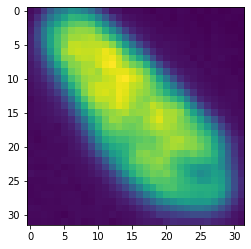

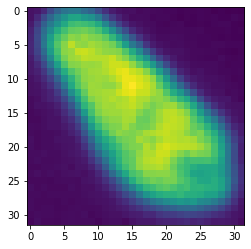

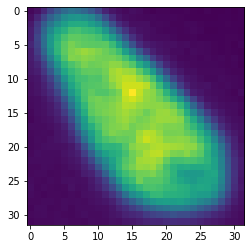

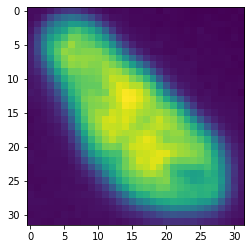

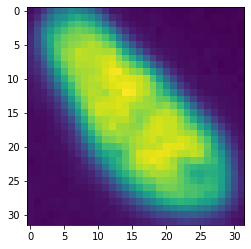

...

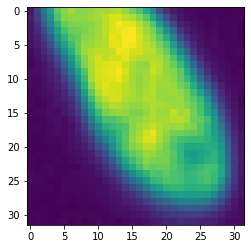

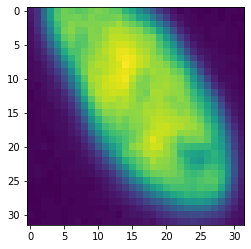

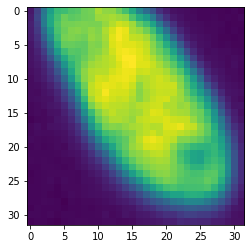

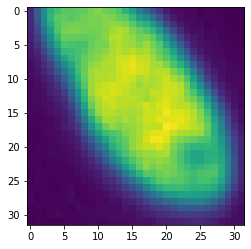

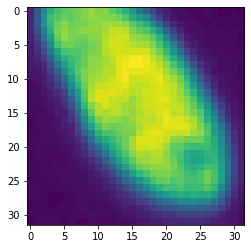

In [203]:
import matplotlib.pyplot as plt

for i in range(32):
    fig, ax = plt.subplots()
    ax.imshow(track_info['appearances'][0][i][1])

In [204]:
temp_std_embeddings_df[100:150]

0     1         2         3         4         5     6         7     \
100 -0.034754   0.0  0.929658 -0.000381 -0.041959 -0.026421   0.0 -0.026526   
101 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
102 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
103 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
104 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
105 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
106 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
107 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
108 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
109 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
110 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
111 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
112 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
113 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
114 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
115 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
116 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
117 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
118 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
119 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
120 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
121 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
122 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
123 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
124 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
125 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
126 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
127 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
128 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
129 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
130 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
131 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
132 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
133 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
134 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
135 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
136 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
137 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
138 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
139 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
140 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
141 -0.034754   0.0 -1.044981 -0.176725  3.661060 -0.026421   0.0 -0.026526   
142 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
143 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
144 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
145 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
146 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
147 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
148 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421   0.0 -0.026526   
149 -0.034754   0.0 -1.044981 -0.176725 -0.041959 -0.026421

In [205]:
features = [str(idx) for idx in range(TE.embedding_dim)]

In [208]:
features[1000:]

['1000',
 '1001',
 '1002',
 '1003',
 '1004',
 '1005',
 '1006',
 '1007',
 '1008',
 '1009',
 '1010',
 '1011',
 '1012',
 '1013',
 '1014',
 '1015',
 '1016',
 '1017',
 '1018',
 '1019',
 '1020',
 '1021',
 '1022',
 '1023']

In [209]:
x = temp_embeddings_df.loc[:, features].values

In [210]:
x[0]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.25535733, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.0198278 , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.00122368,
       0.        , 0.        , 0.47705254, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

In [211]:
x[1]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.24974649, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.0338655 , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.00717478,
       0.        , 0.        , 0.47356734, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.0048703 , 0.     

In [212]:
len(x)

131208

In [213]:
y = temp_embeddings_df.loc[:, ['Frame']].values

In [214]:
y[21]

array([21.])

In [215]:
y[71]

array([0.])

In [216]:
len(y)

131208

In [217]:
x = StandardScaler().fit_transform(x)

In [218]:
x[0]

array([-3.47539618e-02,  0.00000000e+00, -1.04498069e+00, -1.76724992e-01,
       -4.19587696e-02, -2.64212315e-02,  0.00000000e+00, -2.65260234e-02,
       -3.70743107e-02,  0.00000000e+00, -6.81821787e-02, -6.92024111e-02,
        0.00000000e+00, -1.81662796e-01, -9.54992573e-02, -1.10158300e-01,
       -1.38476332e-01,  0.00000000e+00, -1.30530235e-02,  0.00000000e+00,
       -9.31622639e-03, -1.34488691e-01, -5.77496675e-02, -1.64047063e-01,
       -1.30121259e-01, -1.63236704e-01, -2.09098650e-02, -7.22887547e-03,
        1.00193662e+00, -7.28511774e-03, -3.90425477e-03,  0.00000000e+00,
        0.00000000e+00, -5.81590361e-01, -3.76443542e-02,  1.08059310e-02,
        0.00000000e+00,  0.00000000e+00, -1.06844316e-01, -2.70183468e-02,
        0.00000000e+00, -1.01859718e-01, -5.36315838e-02,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00, -5.82876311e-02,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00, -

In [219]:
x[1]

array([-3.47539618e-02,  0.00000000e+00, -1.04498069e+00, -1.76724992e-01,
       -4.19587696e-02, -2.64212315e-02,  0.00000000e+00, -2.65260234e-02,
       -3.70743107e-02,  0.00000000e+00, -6.81821787e-02, -6.92024111e-02,
        0.00000000e+00, -1.81662796e-01, -9.54992573e-02, -1.10158300e-01,
       -1.38476332e-01,  0.00000000e+00, -1.30530235e-02,  0.00000000e+00,
       -9.31622639e-03, -1.34488691e-01, -5.77496675e-02, -1.64047063e-01,
       -1.30121259e-01, -1.63236704e-01, -2.09098650e-02, -7.22887547e-03,
        9.62505634e-01, -7.28511774e-03, -3.90425477e-03,  0.00000000e+00,
        0.00000000e+00, -5.81590361e-01, -3.76443542e-02,  3.65209573e-01,
        0.00000000e+00,  0.00000000e+00, -1.06844316e-01, -2.70183468e-02,
        0.00000000e+00, -1.01859718e-01, -5.36315838e-02,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00, -5.82876311e-02,  0.00000000e+00,
        0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
        0.00000000e+00, -

In [220]:
x = temp_embeddings_df.loc[:, features].values

In [222]:
x[1]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.24974649, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.0338655 , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.00717478,
       0.        , 0.        , 0.47356734, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.0048703 , 0.     

In [223]:
x[0]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.25535733, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.0198278 , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.00122368,
       0.        , 0.        , 0.47705254, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

In [224]:
std_x = StandardScaler().fit_transform(x)

In [226]:
x[0][28]

0.2553573250770569

In [227]:
x[1][28]

0.2497464865446091

In [228]:
std_x[0][28]

1.0019366204657174

In [229]:
std_x[1][28]

0.9625056341360433

In [230]:
x[0][35]

0.019827799871563908

In [231]:
x[1][35]

0.03386550396680832

In [232]:
std_x[0][35]

0.010805930970045195

In [233]:
std_x[1][35]

0.36520957292557055

In [234]:
# the standardizations are NOT the same
# a lot of the values are very small, and should be 0 (they represent 0's in the non-standardized vectors)

In [235]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [str(idx) for idx in range(TE.embedding_dim)]
    x = temp_embeddings_df.loc[:, features].values
    y = temp_embeddings_df.loc[:, ['Frame']].values
    x = StandardScaler().fit_transform(x)
    
    temp_std_embeddings_lst = []
    for i in range(len(x)):
        temp_embeddings = np.append(x[i], y[i][0])
        temp_std_embeddings_lst.append(temp_embeddings)
    
    temp_std_embeddings_df = pd.DataFrame(temp_std_embeddings_lst)
    
    return temp_std_embeddings_df

In [236]:
temp_std_embeddings_df = standardize_embeddings(temp_embeddings_df)

In [237]:
temp_std_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [246]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings(temp_embeddings_df):
    features = [str(idx) for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    frames = temp_embeddings_df.loc[:, ['Frame']].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df, frames

In [247]:
std_embeddings_df = standardize_embeddings(temp_embeddings_df)[0]

In [248]:
std_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [250]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings(temp_embeddings_df):
    std_embeddings_df = standardize_embeddings(temp_embeddings_df)[0]
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat(principal_df, temp_embeddings_df[['frames']], axis = 1)
                          
    return final_df

In [251]:
temp_embeddings_pca_df = project_embeddings(temp_embeddings_df)

KeyError: "None of [Index(['frames'], dtype='object')] are in the [columns]"

In [252]:
frames = standardize_embeddings(temp_embeddings_df)[1]

In [255]:
frames[:5]

array([[0.],
       [1.],
       [2.],
       [3.],
       [4.]])

In [258]:
temp_embeddings_df[:5, 'frames']

TypeError: '(slice(None, 5, None), 'frames')' is an invalid key

In [259]:
temp_embeddings_df.columns

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',
       ...
       '1015', '1016', '1017', '1018', '1019', '1020', '1021', '1022', '1023',
       'Frame'],
      dtype='object', length=1025)

In [262]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings(temp_embeddings_df):
    std_embeddings_df = standardize_embeddings(temp_embeddings_df)[0]
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Frame']]], axis = 1)
                          
    return final_df

In [263]:
temp_embeddings_pca_df = project_embeddings(temp_embeddings_df)

In [264]:
temp_embeddings_pca_df[:5]

,component 1,component 2,Frame
0,2.890864,-2.147104,0.0
1,2.970788,-2.525971,1.0
2,3.455601,-2.413871,2.0
3,2.956276,-2.477715,3.0
4,3.474431,-2.874618,4.0


In [265]:
temp_embeddings_pca_df[69:76]

,component 1,component 2,Frame
69,5.384766,-2.522045,69.0
70,5.666285,-1.117212,70.0
71,-4.909312,1.683260,0.0
72,-4.909312,1.683260,1.0
73,-4.909312,1.683260,2.0
74,-4.909312,1.683260,3.0
75,-4.909312,1.683260,4.0


In [273]:
shape = track_info['appearances'].shape

from random import randint

colors = {k: [] for k in 'rgb'} 
for i in range(shape[1]):
    temp = {k: randint(0, 255) for k in 'rgb'} 
    for k in temp: 
        while 1: 
            c = temp[k]
            # ensure colors are at least 1 apart in each of R, G, and B values
            t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
            if t.intersection(colors[k]): 
                temp[k] = randint(0, 255) 
            else: 
                break 
        colors[k].append(temp[k]) 
colors_lst = [(colors['r'][i], colors['g'][i], colors['b'][i] ) for i in range(shape[1])]

ValueError: 'c' argument has 3 elements, which is inconsistent with 'x' and 'y' with size 0.

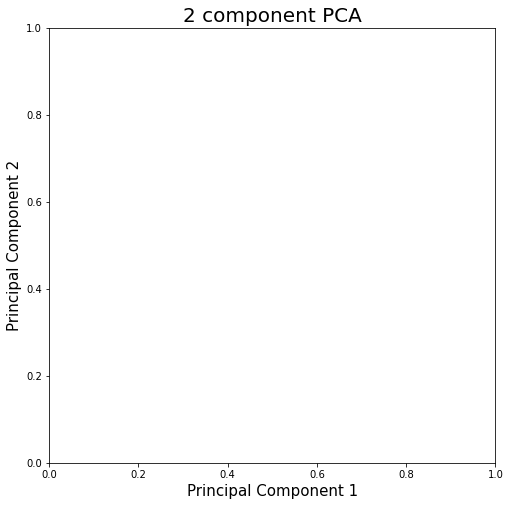

In [278]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indicesToKeep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indicesToKeep, 'component 1'], temp_embeddings_pca_df.loc[indicesToKeep, 'component 2'], c = color, s = 50)
ax.legend(frames)
ax.grid()

In [277]:
colors_lst[0]

(141, 171, 225)

In [279]:
for color in colors_lst:
    color_arr = np.asarray(color)
    for val in color_arr:
        val = [val]
    color = color_arr

In [281]:
colors_lst[0]

(141, 171, 225)

In [282]:
colors_lst = [[colors['r'][i], colors['g'][i], colors['b'][i]] for i in range(shape[1])]

In [283]:
colors_lst[0]

[141, 171, 225]

ValueError: 'c' argument has 3 elements, which is inconsistent with 'x' and 'y' with size 0.

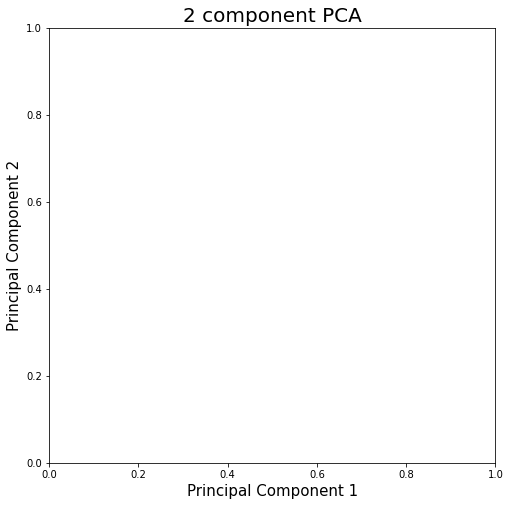

In [284]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indicesToKeep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indicesToKeep, 'component 1'], temp_embeddings_pca_df.loc[indicesToKeep, 'component 2'], c = color, s = 50)
ax.legend(frames)
ax.grid()

In [285]:
colors_lst = [[[colors['r'][i]], [colors['g'][i]], [colors['b'][i]]] for i in range(shape[1])]

ValueError: 'c' argument has 3 elements, which is inconsistent with 'x' and 'y' with size 0.

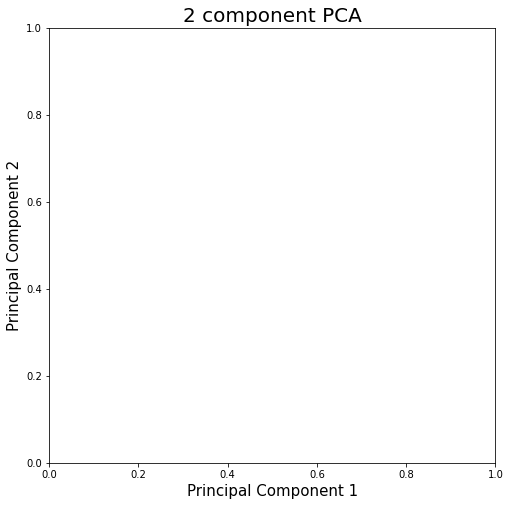

In [286]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indicesToKeep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(frames)
ax.grid()

In [288]:
for color in colors_lst:
    print(color)

[[141], [171], [225]]
[[209], [232], [39]]
[[229], [235], [67]]
[[216], [118], [197]]
[[240], [99], [88]]
[[111], [36], [238]]
[[60], [255], [129]]
[[22], [77], [55]]
[[35], [188], [78]]
[[220], [121], [233]]
[[199], [209], [151]]
[[205], [128], [191]]
[[6], [94], [141]]
[[169], [213], [70]]
[[167], [201], [2]]
[[53], [66], [96]]
[[3], [54], [246]]
[[69], [165], [122]]
[[59], [103], [203]]
[[120], [76], [43]]
[[185], [207], [115]]
[[234], [226], [108]]
[[80], [87], [90]]
[[34], [180], [62]]
[[139], [68], [187]]
[[118], [92], [121]]
[[195], [250], [222]]
[[226], [216], [23]]
[[64], [43], [163]]
[[214], [219], [173]]
[[153], [124], [244]]
[[143], [228], [98]]
[[12], [111], [211]]
[[73], [182], [74]]
[[68], [115], [218]]
[[14], [178], [250]]
[[187], [26], [106]]
[[88], [138], [6]]
[[179], [24], [22]]
[[101], [205], [29]]
[[124], [57], [16]]
[[190], [140], [183]]
[[184], [151], [136]]
[[225], [212], [159]]
[[52], [242], [185]]
[[183], [163], [11]]
[[10], [225], [4]]
[[17], [147], [232]]
[[

In [289]:
colors_lst = [[colors['r'][i], colors['g'][i], colors['b'][i]] for i in range(shape[1])]

In [290]:
for color in colors_lst:
    print(color)

[141, 171, 225]
[209, 232, 39]
[229, 235, 67]
[216, 118, 197]
[240, 99, 88]
[111, 36, 238]
[60, 255, 129]
[22, 77, 55]
[35, 188, 78]
[220, 121, 233]
[199, 209, 151]
[205, 128, 191]
[6, 94, 141]
[169, 213, 70]
[167, 201, 2]
[53, 66, 96]
[3, 54, 246]
[69, 165, 122]
[59, 103, 203]
[120, 76, 43]
[185, 207, 115]
[234, 226, 108]
[80, 87, 90]
[34, 180, 62]
[139, 68, 187]
[118, 92, 121]
[195, 250, 222]
[226, 216, 23]
[64, 43, 163]
[214, 219, 173]
[153, 124, 244]
[143, 228, 98]
[12, 111, 211]
[73, 182, 74]
[68, 115, 218]
[14, 178, 250]
[187, 26, 106]
[88, 138, 6]
[179, 24, 22]
[101, 205, 29]
[124, 57, 16]
[190, 140, 183]
[184, 151, 136]
[225, 212, 159]
[52, 242, 185]
[183, 163, 11]
[10, 225, 4]
[17, 147, 232]
[175, 39, 35]
[166, 215, 117]
[213, 85, 216]
[132, 91, 133]
[47, 11, 85]
[84, 249, 169]
[93, 253, 124]
[38, 15, 171]
[162, 224, 237]
[251, 65, 193]
[150, 231, 51]
[115, 117, 181]
[239, 18, 64]
[172, 8, 58]
[5, 198, 33]
[44, 107, 87]
[250, 137, 9]
[27, 184, 101]
[33, 234, 19]
[37, 134, 146]

ValueError: 'color' kwarg must be an color or sequence of color specs.  For a sequence of values to be color-mapped, use the 'c' argument instead.

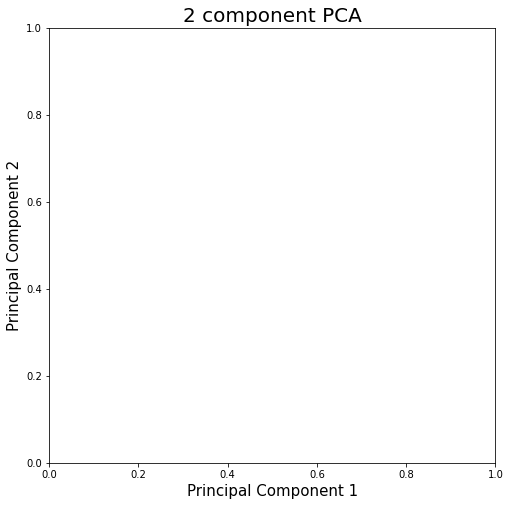

In [292]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], color = color, s = 50)
ax.legend(frames)
ax.grid()

In [293]:
colors_lst = [[colors['r'][i], colors['g'][i], colors['b'][i]] for i in range(shape[1])]

In [294]:
for color in colors_lst:
    print(color)

[141, 171, 225]
[209, 232, 39]
[229, 235, 67]
[216, 118, 197]
[240, 99, 88]
[111, 36, 238]
[60, 255, 129]
[22, 77, 55]
[35, 188, 78]
[220, 121, 233]
[199, 209, 151]
[205, 128, 191]
[6, 94, 141]
[169, 213, 70]
[167, 201, 2]
[53, 66, 96]
[3, 54, 246]
[69, 165, 122]
[59, 103, 203]
[120, 76, 43]
[185, 207, 115]
[234, 226, 108]
[80, 87, 90]
[34, 180, 62]
[139, 68, 187]
[118, 92, 121]
[195, 250, 222]
[226, 216, 23]
[64, 43, 163]
[214, 219, 173]
[153, 124, 244]
[143, 228, 98]
[12, 111, 211]
[73, 182, 74]
[68, 115, 218]
[14, 178, 250]
[187, 26, 106]
[88, 138, 6]
[179, 24, 22]
[101, 205, 29]
[124, 57, 16]
[190, 140, 183]
[184, 151, 136]
[225, 212, 159]
[52, 242, 185]
[183, 163, 11]
[10, 225, 4]
[17, 147, 232]
[175, 39, 35]
[166, 215, 117]
[213, 85, 216]
[132, 91, 133]
[47, 11, 85]
[84, 249, 169]
[93, 253, 124]
[38, 15, 171]
[162, 224, 237]
[251, 65, 193]
[150, 231, 51]
[115, 117, 181]
[239, 18, 64]
[172, 8, 58]
[5, 198, 33]
[44, 107, 87]
[250, 137, 9]
[27, 184, 101]
[33, 234, 19]
[37, 134, 146]

ValueError: 'c' argument has 3 elements, which is inconsistent with 'x' and 'y' with size 0.

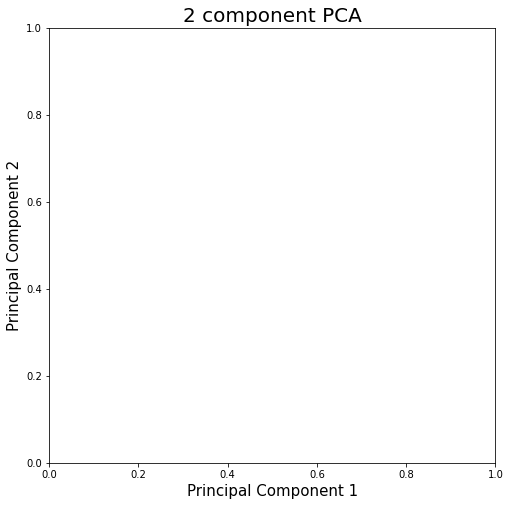

In [296]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(frames)
ax.grid()

In [297]:
colors_lst = [[[colors['r'][i], colors['g'][i], colors['b'][i]]] for i in range(shape[1])]

In [298]:
for color in colors_lst:
    print(color)

[[141, 171, 225]]
[[209, 232, 39]]
[[229, 235, 67]]
[[216, 118, 197]]
[[240, 99, 88]]
[[111, 36, 238]]
[[60, 255, 129]]
[[22, 77, 55]]
[[35, 188, 78]]
[[220, 121, 233]]
[[199, 209, 151]]
[[205, 128, 191]]
[[6, 94, 141]]
[[169, 213, 70]]
[[167, 201, 2]]
[[53, 66, 96]]
[[3, 54, 246]]
[[69, 165, 122]]
[[59, 103, 203]]
[[120, 76, 43]]
[[185, 207, 115]]
[[234, 226, 108]]
[[80, 87, 90]]
[[34, 180, 62]]
[[139, 68, 187]]
[[118, 92, 121]]
[[195, 250, 222]]
[[226, 216, 23]]
[[64, 43, 163]]
[[214, 219, 173]]
[[153, 124, 244]]
[[143, 228, 98]]
[[12, 111, 211]]
[[73, 182, 74]]
[[68, 115, 218]]
[[14, 178, 250]]
[[187, 26, 106]]
[[88, 138, 6]]
[[179, 24, 22]]
[[101, 205, 29]]
[[124, 57, 16]]
[[190, 140, 183]]
[[184, 151, 136]]
[[225, 212, 159]]
[[52, 242, 185]]
[[183, 163, 11]]
[[10, 225, 4]]
[[17, 147, 232]]
[[175, 39, 35]]
[[166, 215, 117]]
[[213, 85, 216]]
[[132, 91, 133]]
[[47, 11, 85]]
[[84, 249, 169]]
[[93, 253, 124]]
[[38, 15, 171]]
[[162, 224, 237]]
[[251, 65, 193]]
[[150, 231, 51]]
[[115, 11

ValueError: RGBA values should be within 0-1 range

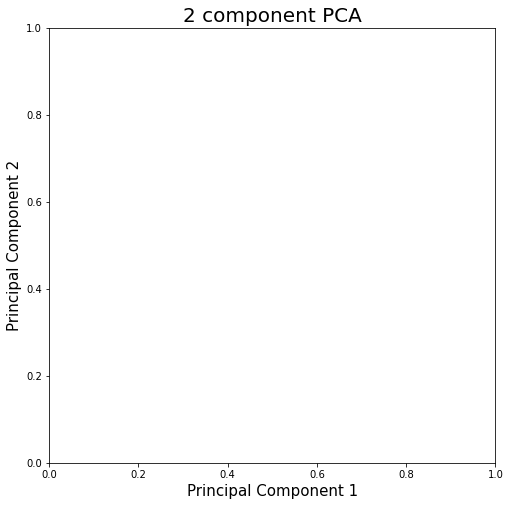

In [299]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = temp_embeddings_pca_df['Frame'] == frame
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(frames)
ax.grid()

In [301]:
colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]

KeyError: False

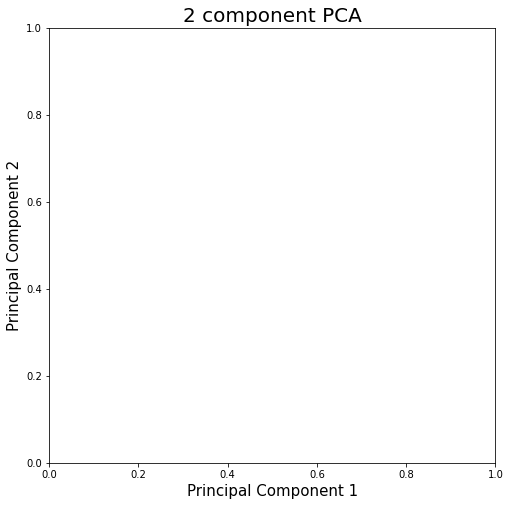

In [318]:
%matplotlib inline

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [str(frame) for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (str(temp_embeddings_pca_df['Frame']) == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

In [310]:
frame = frames[0]
color = colors_lst[0]

In [311]:
frame

'0'

In [312]:
color

[[0.5529411764705883, 0.6705882352941176, 0.8823529411764706]]

In [316]:
indices_to_keep = temp_embeddings_pca_df['Frame'] == frame

In [317]:
indices_to_keep

0         False
1         False
2         False
3         False
4         False
5         False
6         False
7         False
8         False
9         False
10        False
11        False
12        False
13        False
14        False
15        False
16        False
17        False
18        False
19        False
20        False
21        False
22        False
23        False
24        False
25        False
26        False
27        False
28        False
29        False
30        False
31        False
32        False
33        False
34        False
35        False
36        False
37        False
38        False
39        False
40        False
41        False
42        False
43        False
44        False
45        False
46        False
47        False
48        False
49        False
50        False
51        False
52        False
53        False
54        False
55        False
56        False
57        False
58        False
59        False
60        False
61        False
62      

In [319]:
"abc" == "abc"

True

In [320]:
var1 = "abc"
var2 = "abc"

In [321]:
var1 == var2

True

In [322]:
len(temp_embeddings_pca_df)

131208

In [323]:
temp_embeddings_pca_df['Frame'] == '0'

0         False
1         False
2         False
3         False
4         False
5         False
6         False
7         False
8         False
9         False
10        False
11        False
12        False
13        False
14        False
15        False
16        False
17        False
18        False
19        False
20        False
21        False
22        False
23        False
24        False
25        False
26        False
27        False
28        False
29        False
30        False
31        False
32        False
33        False
34        False
35        False
36        False
37        False
38        False
39        False
40        False
41        False
42        False
43        False
44        False
45        False
46        False
47        False
48        False
49        False
50        False
51        False
52        False
53        False
54        False
55        False
56        False
57        False
58        False
59        False
60        False
61        False
62      

In [328]:
indices_to_keep = []
for i in range(len(temp_embeddings_pca_df)):
    if int(temp_embeddings_pca_df.loc[i, 'Frame']) == frame:
        indices_to_keep.append(i)

In [329]:
indices_to_keep

[]

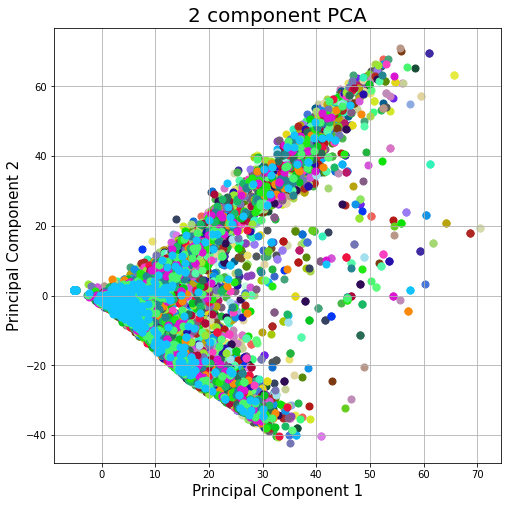

In [330]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [frame for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

In [335]:
shape = track_info['appearances'].shape

from random import randint

def get_rand_colors(num_colors):
    colors = {k: [] for k in 'rgb'} 
    for i in range(num_colors):
        temp = {k: randint(0, 255) for k in 'rgb'} 
        for k in temp: 
            while 1: 
                c = temp[k]
                # ensure colors are at least 1 apart in each of R, G, and B values
                t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
                if t.intersection(colors[k]): 
                    temp[k] = randint(0, 255) 
                else: 
                    break 
            colors[k].append(temp[k]) 
    colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]
    return colors_lst

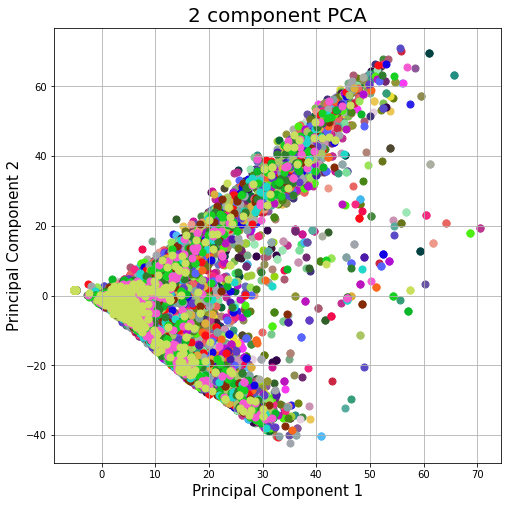

In [336]:
shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [frame for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

In [334]:
colors_lst[0]

(2, 104, 194)

In [337]:
temp_embeddings_pca_df[:5]

,component 1,component 2,Frame
0,2.890864,-2.147104,0.0
1,2.970788,-2.525971,1.0
2,3.455601,-2.413871,2.0
3,2.956276,-2.477715,3.0
4,3.474431,-2.874618,4.0


In [338]:
cols = ['component 1', 'component 2', 'Frame']
temp_embeddings_pca_df.to_csv('temp_embeddings_pca.csv', header=cols)

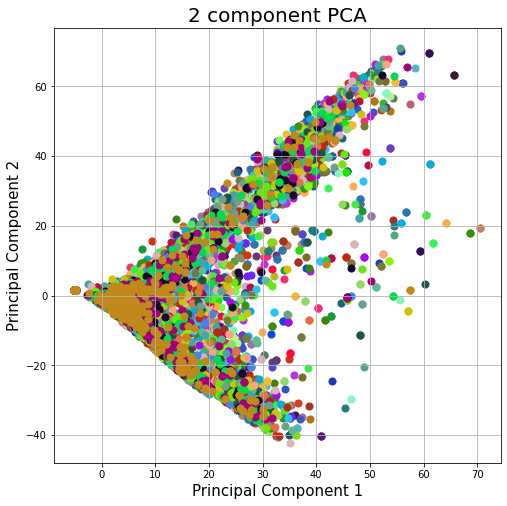

In [339]:
shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [frame for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()
plt.savefig('temp_embeddings_pca.jpg')

In [341]:
import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            # append frame number to embedding
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

from sklearn.preprocessing import StandardScaler

def standardize_embeddings():
    temp_embeddings_df = get_temp_embeddings_df()
    
    features = [str(idx) for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    frames = temp_embeddings_df.loc[:, ['Frame']].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings():
    std_embeddings_df = standardize_embeddings()
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Frame']]], axis = 1)
                          
    return final_df

from random import randint

def get_rand_colors(num_colors):
    colors = {k: [] for k in 'rgb'} 
    for i in range(num_colors):
        temp = {k: randint(0, 255) for k in 'rgb'} 
        for k in temp: 
            while 1: 
                c = temp[k]
                # ensure colors are at least 1 apart in each of R, G, and B values
                t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
                if t.intersection(colors[k]): 
                    temp[k] = randint(0, 255) 
                else: 
                    break 
            colors[k].append(temp[k]) 
    colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]
    return colors_lst

temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [frame for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

KeyError: "None of [Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9',\n       ...\n       '1014', '1015', '1016', '1017', '1018', '1019', '1020', '1021', '1022',\n       '1023'],\n      dtype='object', length=1024)] are in the [columns]"

In [342]:
temp_embeddings_df = get_temp_embeddings_df()

In [343]:
temp_embeddings_df.columns

Index([      0,       1,       2,       3,       4,       5,       6,       7,
             8,       9,
       ...
          1015,    1016,    1017,    1018,    1019,    1020,    1021,    1022,
          1023, 'Frame'],
      dtype='object', length=1025)

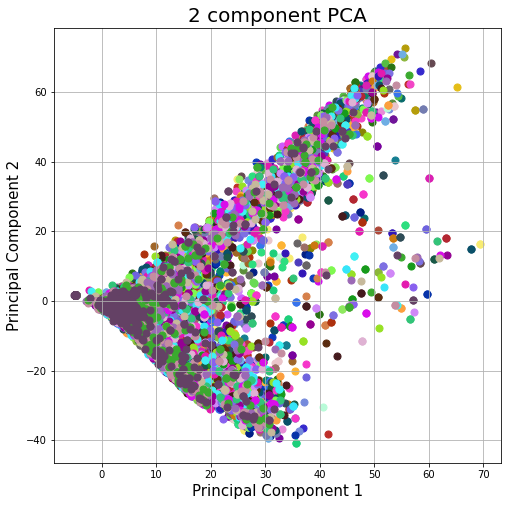

In [344]:
import pandas as pd

def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(embeddings.shape[1]):
            # append frame number to embedding
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), frame))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Frame')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

from sklearn.preprocessing import StandardScaler

def standardize_embeddings():
    temp_embeddings_df = get_temp_embeddings_df()
    
    features = [idx for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    frames = temp_embeddings_df.loc[:, ['Frame']].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings():
    std_embeddings_df = standardize_embeddings()
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Frame']]], axis = 1)
                          
    return final_df

from random import randint

def get_rand_colors(num_colors):
    colors = {k: [] for k in 'rgb'} 
    for i in range(num_colors):
        temp = {k: randint(0, 255) for k in 'rgb'} 
        for k in temp: 
            while 1: 
                c = temp[k]
                # ensure colors are at least 1 apart in each of R, G, and B values
                t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
                if t.intersection(colors[k]): 
                    temp[k] = randint(0, 255) 
                else: 
                    break 
            colors[k].append(temp[k]) 
    colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]
    return colors_lst

temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
frames = [frame for frame in range(shape[1])]
for frame, color in zip(frames, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == frame)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

In [345]:
# Now we need to put the temporal values as frame # - initial frame #

In [346]:
track_info['appearances'].shape

(11, 71, 168, 32, 32, 1)

In [347]:
track_info['lineages'].shape

KeyError: 'lineages'

In [348]:
track_info['centroids'].shape

(11, 71, 168, 2)

In [350]:
track_info['centroids'][0][:][0]

array([[  4.984914,  43.435345],
       [ 17.32413 , 325.42496 ],
       [ 16.034449, 399.88385 ],
       [ 30.542374, 504.48135 ],
       [ 38.817673, 222.67003 ],
       [ 40.739086, 278.184   ],
       [ 48.931   , 151.023   ],
       [ 64.85441 , 405.72647 ],
       [ 70.196556, 360.22955 ],
       [ 67.99408 ,  59.091717],
       [ 90.48252 ,  69.37325 ],
       [ 92.73147 , 496.03766 ],
       [ 94.26511 ,  35.688038],
       [ 97.15015 , 470.2143  ],
       [102.70764 , 285.914   ],
       [109.714096, 417.05402 ],
       [113.35853 , 171.73003 ],
       [134.7459  , 364.51834 ],
       [131.77258 , 108.4871  ],
       [150.0919  , 483.70096 ],
       [165.50372 , 192.37918 ],
       [173.33363 , 429.13437 ],
       [173.6799  ,  46.53125 ],
       [195.49194 , 392.04727 ],
       [194.9398  , 492.34784 ],
       [200.72598 , 337.25546 ],
       [208.69806 ,  88.42518 ],
       [205.79094 , 158.83208 ],
       [204.06445 , 284.125   ],
       [247.53923 ,  54.154064],
       [24

In [370]:
def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        batch = cell // shape[2]
        pos = cell - shape[2] * (cell // shape[2])
        first_frame = 0
        last_frame = 0
        centroids_shape = track_info['centroids'].shape
        for frame in range(centroids_shape[1]):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                first_frame = frame
        for frame in range(centroids_shape[1] - 1, -1, -1):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                last_frame = frame
        
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(first_frame, last_frame + 1):
            # append frame number to embedding
            time = frame - first_frame
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), time))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Time')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

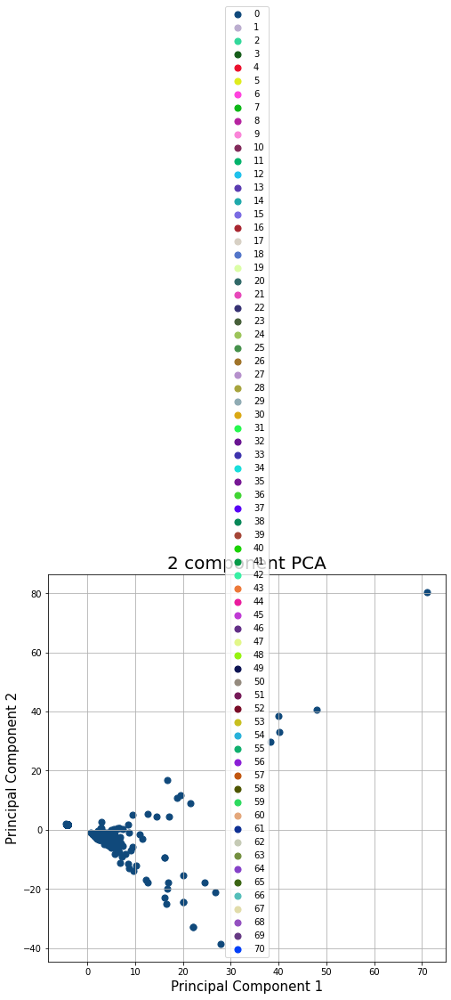

In [375]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings():
    temp_embeddings_df = get_temp_embeddings_df()
    
    features = [idx for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings():
    std_embeddings_df = standardize_embeddings()
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Time']]], axis = 1)
                          
    return final_df

from random import randint

def get_rand_colors(num_colors):
    colors = {k: [] for k in 'rgb'} 
    for i in range(num_colors):
        temp = {k: randint(0, 255) for k in 'rgb'} 
        for k in temp: 
            while 1: 
                c = temp[k]
                # ensure colors are at least 1 apart in each of R, G, and B values
                t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
                if t.intersection(colors[k]): 
                    temp[k] = randint(0, 255) 
                else: 
                    break 
            colors[k].append(temp[k]) 
    colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]
    return colors_lst

temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(times)
ax.grid()

In [358]:
track_info['centroids'][0][0][0]

array([ 4.984914, 43.435345], dtype=float32)

In [361]:
167 // 168

0

In [362]:
num_cells = shape[0] * shape[2]

In [366]:
(num_cells - 1) // 168

10

In [364]:
shape = track_info['appearances'].shape

In [365]:
shape

(11, 71, 168, 32, 32, 1)

In [373]:
temp_embeddings_df = get_temp_embeddings_df()

temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Frame'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

KeyError: "None of [Index(['Frame'], dtype='object')] are in the [columns]"

In [ ]:
plt.savefig('temp_embeddings_pca.jpg')

In [ ]:
cols = ['component 1', 'component 2', 'Frame']
temp_embeddings_pca_df.to_csv('temp_embeddings_pca.csv', header=cols)

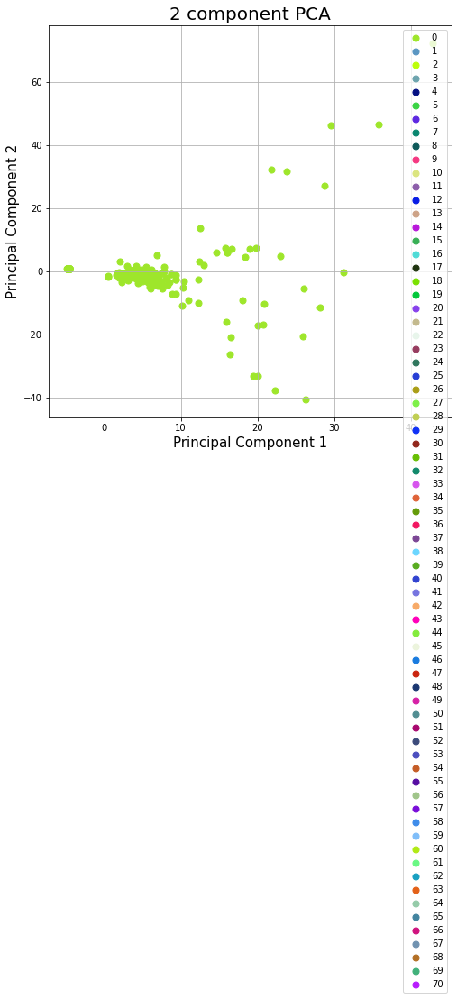

In [377]:
temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(times)
ax.grid()

In [378]:
temp_embeddings_pca_df[:5]

,component 1,component 2,Time
0,-4.730164,0.801963,0.0
1,3.402525,-0.053291,0.0
2,7.166507,-3.301547,0.0
3,3.451905,-0.810341,0.0
4,5.363677,-0.895218,0.0


In [380]:
temp_embeddings_df = get_temp_embeddings_df()

In [381]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [382]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [383]:
for cell in range(num_cells):
    print(cell)
    batch = cell // shape[2]
    pos = cell - shape[2] * (cell // shape[2])
    print(batch, pos)
    first_frame = 0
    last_frame = 0
    centroids_shape = track_info['centroids'].shape
    for frame in range(centroids_shape[1]):
        if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
            first_frame = frame
    for frame in range(centroids_shape[1] - 1, -1, -1):
        if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
            last_frame = frame
    print(first_frame, last_frame)
        
    nxt = it.next()
    inputs = nxt[0]['appearances']
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(first_frame, last_frame + 1):
        # append frame number to embedding
        time = frame - first_frame
        temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), time))

0
0 0
34 0
1
0 1
70 0
2
0 2
70 0
3
0 3
70 0
4
0 4
70 0
5
0 5
70 0
6
0 6
20 0
7
0 7
70 0
8
0 8
70 0
9
0 9
55 0
10
0 10
55 0
11
0 11
70 0
12
0 12
55 0
13
0 13
70 0
14
0 14
39 0
15
0 15
70 0
16
0 16
70 0
17
0 17
70 0
18
0 18
2 0
19
0 19
70 0
20
0 20
46 0
21
0 21
45 0
22
0 22
11 0
23
0 23
70 0
24
0 24
22 0
25
0 25
61 0
26
0 26
13 0
27
0 27
51 0
28
0 28
0 0
29
0 29
70 0
30
0 30
4 0
31
0 31
70 0
32
0 32
70 0
33
0 33
70 0
34
0 34
11 0
35
0 35
70 0
36
0 36
70 0
37
0 37
70 0
38
0 38
70 0
39
0 39
70 0
40
0 40
70 0
41
0 41
70 0
42
0 42
41 0
43
0 43
70 0
44
0 44
32 0
45
0 45
67 0
46
0 46
43 0
47
0 47
54 0
48
0 48
70 0
49
0 49
3 0
50
0 50
70 0
51
0 51
70 0
52
0 52
34 0
53
0 53
70 0
54
0 54
20 0
55
0 55
70 0
56
0 56
31 0
57
0 57
70 0
58
0 58
29 0
59
0 59
62 0
60
0 60
70 0
61
0 61
69 0
62
0 62
70 0
63
0 63
70 0
64
0 64
70 0
65
0 65
70 0
66
0 66
70 0
67
0 67
70 0
68
0 68
70 0
69
0 69
70 0
70
0 70
65 0
71
0 71
70 0
72
0 72
45 0
73
0 73
21 0
74
0 74
70 1
75
0 75
70 1
76
0 76
5 1
77
0 77
53 2
78
0 78
70 

576
3 72
58 0
577
3 73
46 0
578
3 74
38 0
579
3 75
70 0
580
3 76
47 0
581
3 77
41 0
582
3 78
70 0
583
3 79
14 0
584
3 80
70 0
585
3 81
70 0
586
3 82
67 0
587
3 83
70 0
588
3 84
7 0
589
3 85
70 0
590
3 86
70 4
591
3 87
5 4
592
3 88
70 5
593
3 89
70 8
594
3 90
46 8
595
3 91
70 10
596
3 92
70 10
597
3 93
70 11
598
3 94
70 11
599
3 95
70 11
600
3 96
70 13
601
3 97
70 13
602
3 98
70 19
603
3 99
70 19
604
3 100
26 19
605
3 101
24 19
606
3 102
70 20
607
3 103
70 20
608
3 104
31 21
609
3 105
70 21
610
3 106
70 21
611
3 107
70 23
612
3 108
70 26
613
3 109
70 26
614
3 110
70 26
615
3 111
45 28
616
3 112
70 29
617
3 113
70 31
618
3 114
70 39
619
3 115
70 39
620
3 116
70 40
621
3 117
70 42
622
3 118
70 42
623
3 119
70 43
624
3 120
54 46
625
3 121
70 47
626
3 122
70 47
627
3 123
70 48
628
3 124
70 48
629
3 125
53 52
630
3 126
58 57
631
3 127
70 58
632
3 128
70 58
633
3 129
70 58
634
3 130
70 58
635
3 131
70 58
636
3 132
70 59
637
3 133
70 59
638
3 134
70 60
639
3 135
70 60
640
3 136
70 60
641
3 137

KeyboardInterrupt: 

In [384]:
def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        batch = cell // shape[2]
        pos = cell - shape[2] * (cell // shape[2])
        first_frame = 0
        last_frame = 0
        centroids_shape = track_info['centroids'].shape
        for frame in range(centroids_shape[1]):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                first_frame = frame
                break
        for frame in range(centroids_shape[1] - 1, -1, -1):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                last_frame = frame
                break
        
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(first_frame, last_frame + 1):
            # append frame number to embedding
            time = frame - first_frame
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), time))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Time')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

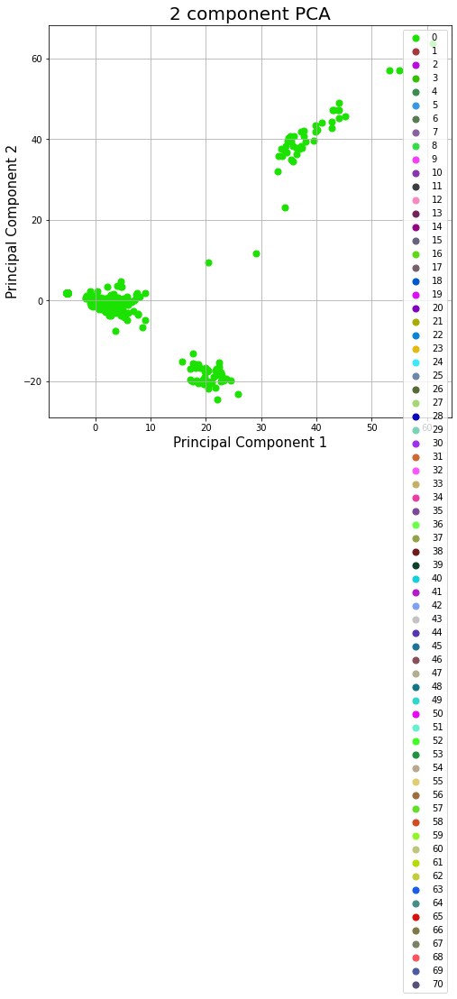

In [385]:
from sklearn.preprocessing import StandardScaler

def standardize_embeddings():
    temp_embeddings_df = get_temp_embeddings_df()
    
    features = [idx for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings():
    std_embeddings_df = standardize_embeddings()
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Time']]], axis = 1)
                          
    return final_df

from random import randint

def get_rand_colors(num_colors):
    colors = {k: [] for k in 'rgb'} 
    for i in range(num_colors):
        temp = {k: randint(0, 255) for k in 'rgb'} 
        for k in temp: 
            while 1: 
                c = temp[k]
                # ensure colors are at least 1 apart in each of R, G, and B values
                t = set(j for j in range(c-1, c+1) if 0 <= j <= 255) 
                if t.intersection(colors[k]): 
                    temp[k] = randint(0, 255) 
                else: 
                    break 
            colors[k].append(temp[k]) 
    colors_lst = [[[colors['r'][i] / 255, colors['g'][i] / 255, colors['b'][i] / 255]] for i in range(shape[1])]
    return colors_lst

temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.legend(times)
ax.grid()

In [386]:
it = iter(train_data)

shape = track_info['appearances'].shape
# number of batches * number of cells per batch
num_cells = shape[0] * shape[2]

temp_embeddings_lst = []

In [387]:
for cell in range(num_cells):
    print(cell)
    batch = cell // shape[2]
    pos = cell - shape[2] * (cell // shape[2])
    print(batch, pos)
    first_frame = 0
    last_frame = 0
    centroids_shape = track_info['centroids'].shape
    for frame in range(centroids_shape[1]):
        if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
            first_frame = frame
            break
    for frame in range(centroids_shape[1] - 1, -1, -1):
        if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
            last_frame = frame
            break
    print(first_frame, last_frame)
        
    nxt = it.next()
    inputs = nxt[0]['appearances']
    app_encoded = TE.app_encoder(inputs)
    embeddings = TE.embedding_model(app_encoded)
    # embeddings.shape = (1, 71, 1024)
    for frame in range(first_frame, last_frame + 1):
        # append frame number to embedding
        time = frame - first_frame
        temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), time))

0
0 0
0 34
1
0 1
0 70
2
0 2
0 70
3
0 3
0 70
4
0 4
0 70
5
0 5
0 70
6
0 6
0 20
7
0 7
0 70
8
0 8
0 70
9
0 9
0 55
10
0 10
0 55
11
0 11
0 70
12
0 12
0 55
13
0 13
0 70
14
0 14
0 39
15
0 15
0 70
16
0 16
0 70
17
0 17
0 70
18
0 18
0 2
19
0 19
0 70
20
0 20
0 46
21
0 21
0 45
22
0 22
0 11
23
0 23
0 70
24
0 24
0 22
25
0 25
0 61
26
0 26
0 13
27
0 27
0 51
28
0 28
0 0
29
0 29
0 70
30
0 30
0 4
31
0 31
0 70
32
0 32
0 70
33
0 33
0 70
34
0 34
0 11
35
0 35
0 70
36
0 36
0 70
37
0 37
0 70
38
0 38
0 70
39
0 39
0 70
40
0 40
0 70
41
0 41
0 70
42
0 42
0 41
43
0 43
0 70
44
0 44
0 32
45
0 45
0 67
46
0 46
0 43
47
0 47
0 54
48
0 48
0 70
49
0 49
0 3
50
0 50
0 70
51
0 51
0 70
52
0 52
0 34
53
0 53
0 70
54
0 54
0 20
55
0 55
0 70
56
0 56
0 31
57
0 57
0 70
58
0 58
0 29
59
0 59
0 62
60
0 60
0 70
61
0 61
0 69
62
0 62
0 70
63
0 63
0 70
64
0 64
0 70
65
0 65
0 70
66
0 66
0 70
67
0 67
0 70
68
0 68
0 70
69
0 69
0 70
70
0 70
0 65
71
0 71
0 70
72
0 72
0 45
73
0 73
0 21
74
0 74
1 70
75
0 75
1 70
76
0 76
1 5
77
0 77
2 53
78
0 78
3 7

576
3 72
0 58
577
3 73
0 46
578
3 74
0 38
579
3 75
0 70
580
3 76
0 47
581
3 77
0 41
582
3 78
0 70
583
3 79
0 14
584
3 80
0 70
585
3 81
0 70
586
3 82
0 67
587
3 83
0 70
588
3 84
0 7
589
3 85
0 70
590
3 86
4 70
591
3 87
4 5
592
3 88
5 70
593
3 89
8 70
594
3 90
8 46
595
3 91
10 70
596
3 92
10 70
597
3 93
11 70
598
3 94
11 70
599
3 95
11 70
600
3 96
13 70
601
3 97
13 70
602
3 98
19 70
603
3 99
19 70
604
3 100
19 26
605
3 101
19 24
606
3 102
20 70
607
3 103
20 70
608
3 104
21 31
609
3 105
21 70
610
3 106
21 70
611
3 107
23 70
612
3 108
26 70
613
3 109
26 70
614
3 110
26 70
615
3 111
28 45
616
3 112
29 70
617
3 113
31 70
618
3 114
39 70
619
3 115
39 70
620
3 116
40 70
621
3 117
42 70
622
3 118
42 70
623
3 119
43 70
624
3 120
46 54
625
3 121
47 70
626
3 122
47 70
627
3 123
48 70
628
3 124
48 70
629
3 125
52 53
630
3 126
57 58
631
3 127
58 70
632
3 128
58 70
633
3 129
58 70
634
3 130
58 70
635
3 131
58 70
636
3 132
59 70
637
3 133
59 70
638
3 134
60 70
639
3 135
60 70
640
3 136
60 70
641
3 137

1138
6 130
0 0
1139
6 131
0 0
1140
6 132
0 0
1141
6 133
0 0
1142
6 134
0 0
1143
6 135
0 0
1144
6 136
0 0
1145
6 137
0 0
1146
6 138
0 0
1147
6 139
0 0
1148
6 140
0 0
1149
6 141
0 0
1150
6 142
0 0
1151
6 143
0 0
1152
6 144
0 0
1153
6 145
0 0
1154
6 146
0 0
1155
6 147
0 0
1156
6 148
0 0
1157
6 149
0 0
1158
6 150
0 0
1159
6 151
0 0
1160
6 152
0 0
1161
6 153
0 0
1162
6 154
0 0
1163
6 155
0 0
1164
6 156
0 0
1165
6 157
0 0
1166
6 158
0 0
1167
6 159
0 0
1168
6 160
0 0
1169
6 161
0 0
1170
6 162
0 0
1171
6 163
0 0
1172
6 164
0 0
1173
6 165
0 0
1174
6 166
0 0
1175
6 167
0 0
1176
7 0
0 70
1177
7 1
0 70
1178
7 2
0 13
1179
7 3
0 70
1180
7 4
0 8
1181
7 5
0 59
1182
7 6
0 70
1183
7 7
0 4
1184
7 8
0 35
1185
7 9
0 70
1186
7 10
0 70
1187
7 11
0 12
1188
7 12
0 70
1189
7 13
0 61
1190
7 14
0 70
1191
7 15
0 57
1192
7 16
0 59
1193
7 17
0 70
1194
7 18
0 42
1195
7 19
0 66
1196
7 20
0 11
1197
7 21
0 70
1198
7 22
0 70
1199
7 23
0 61
1200
7 24
0 50
1201
7 25
0 70
1202
7 26
0 16
1203
7 27
0 14
1204
7 28
0 42
1205
7 

1682
10 2
0 37
1683
10 3
0 70
1684
10 4
0 70
1685
10 5
0 70
1686
10 6
0 70
1687
10 7
0 47
1688
10 8
0 70
1689
10 9
0 70
1690
10 10
0 70
1691
10 11
0 63
1692
10 12
0 70
1693
10 13
0 52
1694
10 14
0 17
1695
10 15
0 70
1696
10 16
0 0
1697
10 17
0 70
1698
10 18
0 70
1699
10 19
0 14
1700
10 20
0 70
1701
10 21
0 70
1702
10 22
0 70
1703
10 23
0 70
1704
10 24
0 34
1705
10 25
0 70
1706
10 26
0 70
1707
10 27
0 14
1708
10 28
0 70
1709
10 29
0 70
1710
10 30
0 70
1711
10 31
0 70
1712
10 32
0 30
1713
10 33
0 22
1714
10 34
0 16
1715
10 35
0 70
1716
10 36
0 20
1717
10 37
0 66
1718
10 38
0 70
1719
10 39
0 70
1720
10 40
0 47
1721
10 41
0 70
1722
10 42
0 43
1723
10 43
0 70
1724
10 44
0 70
1725
10 45
0 46
1726
10 46
0 39
1727
10 47
0 22
1728
10 48
0 68
1729
10 49
0 70
1730
10 50
0 23
1731
10 51
0 52
1732
10 52
0 70
1733
10 53
0 70
1734
10 54
0 70
1735
10 55
0 70
1736
10 56
0 70
1737
10 57
0 70
1738
10 58
0 39
1739
10 59
0 70
1740
10 60
0 59
1741
10 61
0 24
1742
10 62
0 70
1743
10 63
0 70
1744
10 64
0 70
1

In [388]:
temp_embeddings_df = get_temp_embeddings_df()

In [389]:
temp_embeddings_df[:5]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [390]:
temp_embeddings_df[69:76]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [391]:
temp_embeddings_pca_df = project_embeddings()

In [392]:
temp_embeddings_df[100:105]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [393]:
temp_embeddings_df[200:205]

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [395]:
temp_embeddings_lst[0][-1]

0.0

In [397]:
temp_embeddings_lst[1][-1]

1.0

In [398]:
temp_embeddings_lst[2][-1]

2.0

In [399]:
temp_embeddings_lst[70][-1]

35.0

In [400]:
temp_embeddings_lst[0]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.22119708, 0.        ,
       0.        , 0.        , 0.        , 0.05988181, 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.19082661, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

In [401]:
temp_embeddings_lst[1]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.22978637, 0.        ,
       0.        , 0.        , 0.        , 0.0228104 , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.20297866, 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

In [402]:
temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

time = 1
indices_to_keep = (temp_embeddings_pca_df['Time'] == time)

In [403]:
indices_to_keep

0        False
1         True
2        False
3        False
4        False
5        False
6        False
7        False
8        False
9        False
10       False
11       False
12       False
13       False
14       False
15       False
16       False
17       False
18       False
19       False
20       False
21       False
22       False
23       False
24       False
25       False
26       False
27       False
28       False
29       False
30       False
31       False
32       False
33       False
34       False
35       False
36        True
37       False
38       False
39       False
40       False
41       False
42       False
43       False
44       False
45       False
46       False
47       False
48       False
49       False
50       False
51       False
52       False
53       False
54       False
55       False
56       False
57       False
58       False
59       False
60       False
61       False
62       False
63       False
64       False
65       False
66       F

In [404]:
time = 30
indices_to_keep = (temp_embeddings_pca_df['Time'] == time)

In [405]:
indices_to_keep

0        False
1        False
2        False
3        False
4        False
5        False
6        False
7        False
8        False
9        False
10       False
11       False
12       False
13       False
14       False
15       False
16       False
17       False
18       False
19       False
20       False
21       False
22       False
23       False
24       False
25       False
26       False
27       False
28       False
29       False
30        True
31       False
32       False
33       False
34       False
35       False
36       False
37       False
38       False
39       False
40       False
41       False
42       False
43       False
44       False
45       False
46       False
47       False
48       False
49       False
50       False
51       False
52       False
53       False
54       False
55       False
56       False
57       False
58       False
59       False
60       False
61       False
62       False
63       False
64       False
65        True
66       F

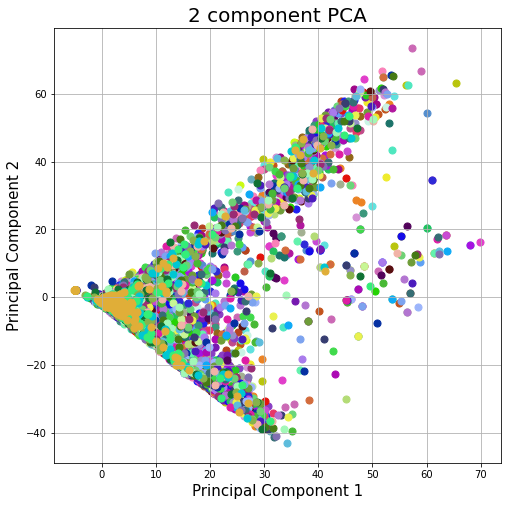

In [406]:
temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()

In [407]:
plt.savefig('time_embeddings_pca.jpg')

<Figure size 432x288 with 0 Axes>

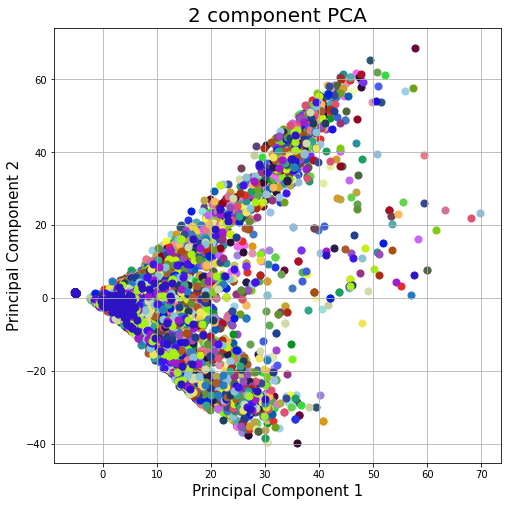

In [409]:
temp_embeddings_pca_df = project_embeddings()

shape = track_info['appearances'].shape
colors_lst = get_rand_colors(shape[1])

fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
times = [time for time in range(shape[1])]
for time, color in zip(times, colors_lst):
    indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
    ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = color, s = 50)
ax.grid()
plt.savefig('time_embeddings_pca.jpg')

In [ ]:
def get_temp_embeddings_df():
    it = iter(train_data)

    shape = track_info['appearances'].shape
    # number of batches * number of cells per batch
    num_cells = shape[0] * shape[2]

    temp_embeddings_lst = []

    for cell in range(num_cells):
        batch = cell // shape[2]
        pos = cell - shape[2] * (cell // shape[2])
        first_frame = 0
        last_frame = 0
        centroids_shape = track_info['centroids'].shape
        for frame in range(centroids_shape[1]):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                first_frame = frame
                break
        for frame in range(centroids_shape[1] - 1, -1, -1):
            if not np.array_equal(track_info['centroids'][batch][frame][pos], np.zeros(2, dtype='float32')):
                last_frame = frame
                break
        
        nxt = it.next()
        inputs = nxt[0]['appearances']
        app_encoded = TE.app_encoder(inputs)
        embeddings = TE.embedding_model(app_encoded)
        # embeddings.shape = (1, 71, 1024)
        for frame in range(first_frame, last_frame + 1):
            # append frame number to embedding
            time = frame - first_frame
            temp_embeddings_lst.append(numpy.append(embeddings[0][frame].numpy().astype('float32'), time))
            
    cols = [idx for idx in range(TE.embedding_dim)]
    cols.append('Time')
    temp_embeddings_df = pd.DataFrame(temp_embeddings_lst, columns=cols)
    
    return temp_embeddings_df

from sklearn.preprocessing import StandardScaler

def standardize_embeddings():
    temp_embeddings_df = get_temp_embeddings_df()
    
    features = [idx for idx in range(TE.embedding_dim)]
    embeddings = temp_embeddings_df.loc[:, features].values
    std_embeddings = StandardScaler().fit_transform(embeddings)
    
    std_embeddings_df = pd.DataFrame(std_embeddings)
    
    return std_embeddings_df

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

def project_embeddings():
    std_embeddings_df = standardize_embeddings()
    
    principal_components = pca.fit_transform(std_embeddings_df)
    principal_df = pd.DataFrame(data = principal_components, columns = ['component 1', 'component 2'])
    
    final_df = pd.concat([principal_df, temp_embeddings_df[['Time']]], axis = 1)
                          
    return final_df

temp_embeddings_df = get_temp_embeddings_df()
temp_embeddings_pca_df = project_embeddings()

import math

for time_sect in range(10):
    time_init = math.floor(shape[1] * time_sect / 10)
    time_final = math.floor(shape[1] * (time_sect + 1) / 10) - 1
    fig = plt.figure(figsize = (8,8))
    ax = fig.add_subplot(1,1,1) 
    ax.set_xlabel('Principal Component 1', fontsize = 15)
    ax.set_ylabel('Principal Component 2', fontsize = 15)
    ax.set_title('2 component PCA: Time ' + str(time_init) + ' - ' + str(time_final), fontsize = 20)
    times = [time for time in range(time_init, time_final + 1)]
    for time in times:
        indices_to_keep = (temp_embeddings_pca_df['Time'] == time)
        color = colors_lst[time_sect]
        ax.scatter(temp_embeddings_pca_df.loc[indices_to_keep, 'component 1'], temp_embeddings_pca_df.loc[indices_to_keep, 'component 2'], c = 'black', s = 50)
    ax.grid()
    plt.savefig('time_embeddings_sections/time_embeddings_pca_' + str(time_init) + '_' + str(time_final) + '.jpg')